In [1]:
%matplotlib inline
import os
import cv2
import random
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt

In [2]:
def Image_Data(dir_path, MPN = 1):
    image_list = os.listdir(dir_path)
    image_list.sort()
    
    list_len = len(image_list)
    print("이미지 파일 총 갯수 : ",list_len)
    
    image1 = []
    image2 = []
    CoN = [] # correct[0 1] or not[0 1]
    
    #--- 묶음 제작
    
    pick_num = 10 # 뽑을 묶음 수
    saved_name = image_list[0][:4] # ID가 이름의 4번째까지 이므로
    front = 0
    back = 0
    
    for index, img_name in enumerate(image_list):
        if img_name[:4] == saved_name and index+1 != list_len:
            continue
        saved_name = img_name[:4]
        back = index
        if back-front == 1:
            front = index
            continue
        for i in range(pick_num):
            D1,D2 = random.sample(range(front,back),2)
            image1.append(D1)
            image2.append(D2)
            CoN.append([0,1])
        for i in range(pick_num*MPN):
            D1 = random.sample(range(front,back),1)
            while(True):
                D2 = random.sample(range(0,list_len),1)
                if front>D2[0] or D2[0]>back: break
            image1.extend(D1)
            image2.extend(D2)
            CoN.append([1,0])
        front = index
        
    CoN=np.asarray(CoN)
    
    nsp, sp = np.sum(CoN,axis=0)
    print("Total : ",len(CoN))
    print("같은사람 : ",sp)
    print("다른사람 : ",nsp)
    
    return image_list, image1, image2, CoN

In [3]:
### For Testing ###
# testing_number 만큼의 사람들을 그 만큼 모두 짝지어 리턴해줍니다.

def ALL_Image_Data(dir_path, testing_number = 100):
    image_list = os.listdir(dir_path)
    image_list.sort()
    
    list_len = len(image_list)
    print("이미지 파일 총 갯수 : ",list_len)
    print("뽑을 사람 : ",testing_number)
    
    image1 = []
    image2 = []
    CoN = [] # correct[0 1] or not[0 1]
    
    
    ### testing_number 만큼의 사람이 어디까진지 파악하는 코드 ###
    saved_name = image_list[0][:4] # ID가 이름의 4번째까지 이므로
    number_of_people = 1
    
    for index, img_name in enumerate(image_list):
        if testing_number+1 == number_of_people: break
        if img_name[:4] == saved_name:
            continue
        saved_name = img_name[:4]
        number_of_people += 1
    list_len = index-1
    print(testing_number,"명 만큼의 사람의 사진은",list_len,"장 입니다.")
    ### -------------------------------------------------- ###
    
    saved_name = image_list[0][:4]
    front = 0
    back = 0
    
    for index, img_name in enumerate(image_list[:list_len]):
        
        if img_name[:4] == saved_name and index+1 != list_len:
            continue
        if index+1 == list_len: index = list_len
            
        saved_name = img_name[:4]
        back = index
        
        if back-front == 1:
            front = index
            continue
        
        image1.extend([front] * (list_len-1))
        image2.extend(list(range(0,front))+list(range(front+1,list_len)))
        for i in range(front):CoN.append([1,0])
        for i in range(back-front-1): CoN.append([0,1])
        for i in range(list_len-back): CoN.append([1,0])
        
        front = index
    
    CoN=np.asarray(CoN)
    return image_list, image1, image2, CoN

이미지 파일 총 갯수 :  14097
Total :  88020
같은사람 :  14670
다른사람 :  73350
first pic =  0000_02.jpg
second pic =  0000_03.jpg
answer is =  [0 1]


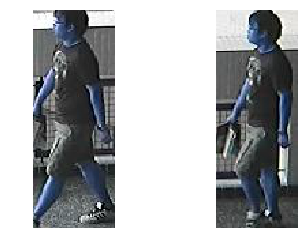

first pic =  0000_02.jpg
second pic =  0000_05.jpg
answer is =  [0 1]


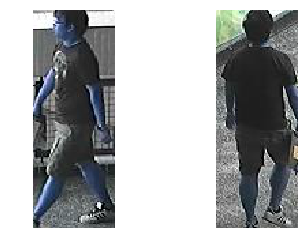

first pic =  0000_05.jpg
second pic =  0000_03.jpg
answer is =  [0 1]


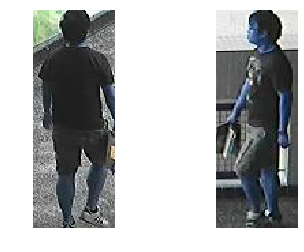

first pic =  0000_09.jpg
second pic =  0000_02.jpg
answer is =  [0 1]


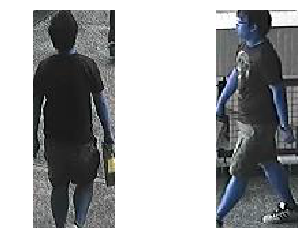

first pic =  0000_04.jpg
second pic =  0000_00.jpg
answer is =  [0 1]


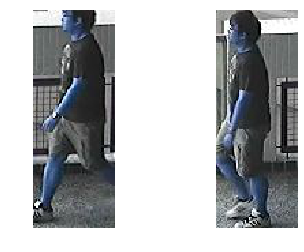

first pic =  0000_09.jpg
second pic =  0000_08.jpg
answer is =  [0 1]


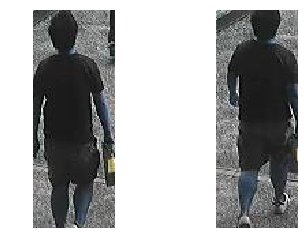

first pic =  0000_02.jpg
second pic =  0000_08.jpg
answer is =  [0 1]


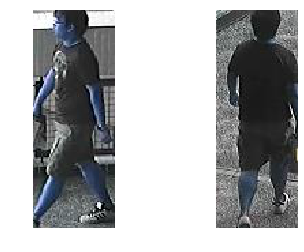

first pic =  0000_08.jpg
second pic =  0000_06.jpg
answer is =  [0 1]


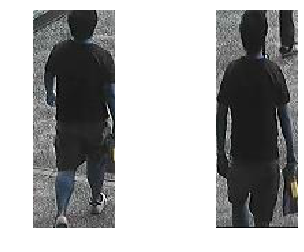

first pic =  0000_06.jpg
second pic =  0000_00.jpg
answer is =  [0 1]


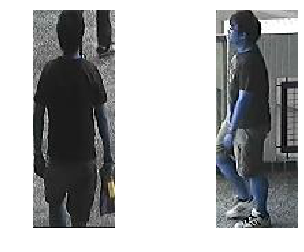

first pic =  0000_06.jpg
second pic =  0000_09.jpg
answer is =  [0 1]


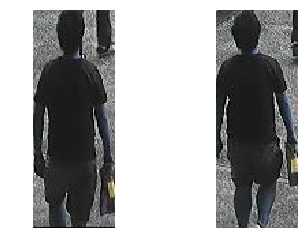

In [4]:
train_dir = '/home/esdl/tensorflow/cuhk03_release/images/detected'
train_list, train_data1, train_data2, train_CoN = Image_Data(train_dir,5)

data_index = list(range(len(train_data1)))

for i in data_index[:10]:
    img1 = cv2.imread(train_dir+'/'+train_list[train_data1[i]],cv2.IMREAD_COLOR)
    img2 = cv2.imread(train_dir+'/'+train_list[train_data2[i]],cv2.IMREAD_COLOR)
    fig , ax = plt.subplots(1, 2)
    ax[0].set_axis_off()
    ax[1].set_axis_off()

    ax[0].imshow(img1)
    ax[1].imshow(img2)
    
    print("first pic = ",train_list[train_data1[i]])
    print("second pic = ",train_list[train_data2[i]])
    print("answer is = ",train_CoN[i])
    plt.show()
    plt.close(fig)

이미지 파일 총 갯수 :  3884
Total :  19420
같은사람 :  9710
다른사람 :  9710
first pic =  0962001.png
second pic =  0962004.png
answer is =  [0 1]


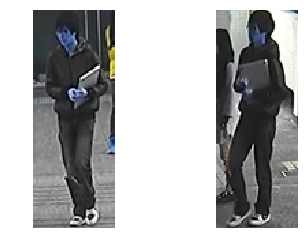

first pic =  0182002.png
second pic =  0182001.png
answer is =  [0 1]


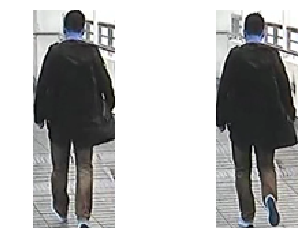

first pic =  0627003.png
second pic =  0627001.png
answer is =  [0 1]


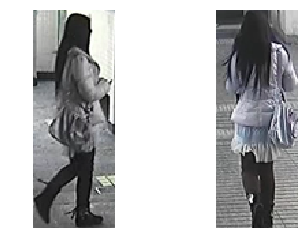

first pic =  0280004.png
second pic =  0689001.png
answer is =  [1 0]


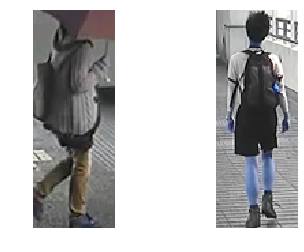

first pic =  0228004.png
second pic =  0155003.png
answer is =  [1 0]


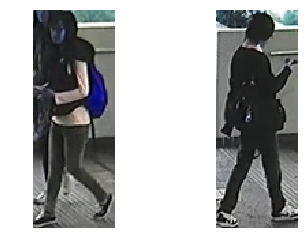

first pic =  0124001.png
second pic =  0703003.png
answer is =  [1 0]


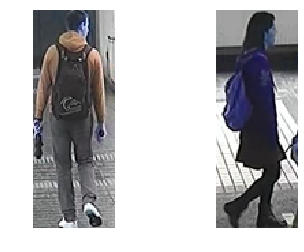

first pic =  0021004.png
second pic =  0167003.png
answer is =  [1 0]


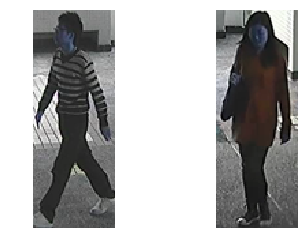

first pic =  0261001.png
second pic =  0028001.png
answer is =  [1 0]


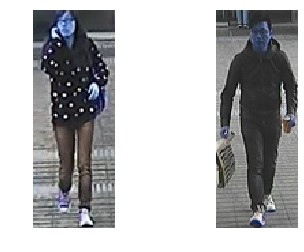

first pic =  0050002.png
second pic =  0050001.png
answer is =  [0 1]


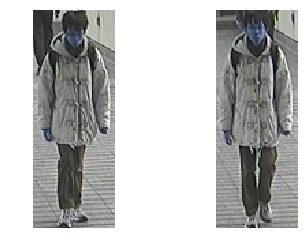

first pic =  0969002.png
second pic =  0892001.png
answer is =  [1 0]


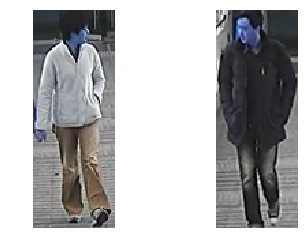

In [5]:
test_dir = '/home/esdl/tensorflow/campus'
test_list, test_data1, test_data2, test_CoN = Image_Data(test_dir)

test_data_index = list(range(len(test_data1)))
random.shuffle(test_data_index)

for i in test_data_index[:10]:
    img1 = cv2.imread(test_dir+'/'+test_list[test_data1[i]],cv2.IMREAD_COLOR)
    img2 = cv2.imread(test_dir+'/'+test_list[test_data2[i]],cv2.IMREAD_COLOR)
    fig , ax = plt.subplots(1, 2)
    ax[0].set_axis_off()
    ax[1].set_axis_off()

    ax[0].imshow(img1)
    ax[1].imshow(img2)
    
    print("first pic = ",test_list[test_data1[i]])
    print("second pic = ",test_list[test_data2[i]])
    print("answer is = ",test_CoN[i])
    plt.show()
    plt.close(fig)

In [6]:
def CrossND (input1, input2, stride = 3):
    # padding stride 미적용 일단 3으로 할 것
    L = len(input1.shape)
    if L==2: print("3차원 이상만 가능합니다.")
    elif L==3: paddings = tf.constant([[0, 0], [1, 1], [1, 1]])
    elif L==4: paddings = tf.constant([[0, 0], [0, 0], [1, 1], [1, 1]])
    else: print("미구현됨...")
        
    input2 = tf.pad(input2, paddings, "CONSTANT")
    for i in range(input1.shape[L-2]):
        if L==3: F1 = tf.subtract(tf.reshape(input1[:,i,0],[input1.shape[L-3],1,1]),input2[:,i:i+stride,:stride])
        elif L==4: F1 = tf.subtract(tf.reshape(input1[:,:,i,0],[-1,input1.shape[L-3],1,1]),input2[:,:,i:i+stride,:stride])
        F1 = tf.abs(F1)
        for j in range(input1.shape[L-1]):
            if j == 0: continue
            if L==3: F2 = tf.subtract(tf.reshape(input1[:,i,j],[input1.shape[L-3],1,1]),input2[:,i:i+stride,j:j+stride])
            elif L==4: F2 = tf.subtract(tf.reshape(input1[:,:,i,j],[-1,input1.shape[L-3],1,1]),input2[:,:,i:i+stride,j:j+stride])
            F2 = tf.abs(F2)
            F1 = tf.concat([F1,F2],L-1)
        if i==0:
            output = F1
            continue
        output = tf.concat([output,F1],L-2)
    return output

In [22]:
def ConvNet(x, in_channels, filter_count, batch_prob, filter_size = 3, mu = 0.5, sigma = 0.01, padding = 'SAME'):
    # W = tf.Variable(tf.random_normal([filter_size,filter_size,in_channels,filter_count], stddev = sigma))
    # b = tf.Variable(tf.random_normal([1,1,filter_count], mean = mu, stddev = sigma))
    W = tf.get_variable("W",[filter_size,filter_size,in_channels,filter_count],initializer=tf.random_normal_initializer(0, sigma))
    b = tf.get_variable("b",[1,1,filter_count],initializer=tf.random_normal_initializer(mu, sigma))
    x = tf.nn.conv2d(x,W,strides=[1,1,1,1],padding=padding)
    x = tf.add(x,b)
    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob, name = "batch_norm")
    return tf.nn.relu(x)

In [8]:
def inception2d(x, in_channels, filter_count, batch_prob, mu=0, sigma=0.01):
    # bias dimension = 3*filter_count and then the extra in_channels for the avg pooling
    # bias = tf.get_variable("bias",tf.truncated_normal([3*filter_count + in_channels], mu, sigma))
    bias = tf.get_variable("bias",[3*filter_count + in_channels],initializer=tf.initializers.truncated_normal(mu,sigma))
    
    # 1x1
    # one_filter = tf.get_variable("one_filter",tf.truncated_normal([1, 1, in_channels, filter_count], mu, sigma))
    one_filter = tf.get_variable("one_filter",[1, 1, in_channels, filter_count],initializer=tf.initializers.truncated_normal(mu,sigma))
    one_by_one = tf.nn.conv2d(x, one_filter, strides=[1, 1, 1, 1], padding='SAME')
    one_by_one = tf.layers.batch_normalization(one_by_one, center=True, scale=True, training=batch_prob, name = "batch_norm1")
    
    # 3x3
    # three_filter = tf.get_variable("three_filter",tf.truncated_normal([3, 3, in_channels, filter_count], mu, sigma))
    three_filter = tf.get_variable("three_filter",[3, 3, in_channels, filter_count],initializer=tf.initializers.truncated_normal(mu,sigma))
    three_by_three = tf.nn.conv2d(x, three_filter, strides=[1, 1, 1, 1], padding='SAME')
    three_by_three = tf.layers.batch_normalization(three_by_three, center=True, scale=True, training=batch_prob, name = "batch_norm2")
    
    # 5x5
    # five_filter = tf.get_variable("five_filter",tf.truncated_normal([5, 5, in_channels, filter_count], mu, sigma))
    five_filter = tf.get_variable("five_filter",[5, 5, in_channels, filter_count],initializer=tf.initializers.truncated_normal(mu,sigma))
    five_by_five = tf.nn.conv2d(x, five_filter, strides=[1, 1, 1, 1], padding='SAME')
    five_by_five = tf.layers.batch_normalization(five_by_five, center=True, scale=True, training=batch_prob, name = "batch_norm3")
    
    # avg pooling
    pooling = tf.nn.avg_pool(x, ksize=[1, 3, 3, 1], strides=[1, 1, 1, 1], padding='SAME')
    
    x = tf.concat([one_by_one, three_by_three, five_by_five, pooling], axis=3)  # Concat in the 4th dim to stack
    
    #x = tf.nn.bias_add(x, bias)
    x = tf.add(x, bias)
    
    return tf.nn.relu(x)

In [9]:
def inception2d_v2(x, in_channels, filter_count, batch_prob, mu=0, sigma=0.01):
    
    # 1x1
    one_filter_1 = tf.get_variable("one_filter_1",[1, 1, in_channels, filter_count[0]],initializer=tf.initializers.truncated_normal(mu,sigma))
    one_by_one = tf.nn.conv2d(x, one_filter_1, strides=[1, 1, 1, 1], padding='SAME')
    one_by_one = tf.layers.batch_normalization(one_by_one, center=True, scale=True, training=batch_prob, name = "batch_norm1")
    
    # 3x3
    one_filter_3 = tf.get_variable("one_filter_3",[1, 1, in_channels, int(filter_count[1]*(2/3))],initializer=tf.initializers.truncated_normal(mu,sigma))
    three_filter = tf.get_variable("three_filter",[3, 3, int(filter_count[1]*(2/3)), filter_count[1]],initializer=tf.initializers.truncated_normal(mu,sigma))
    three_by_three = tf.nn.conv2d(x, one_filter_3, strides=[1, 1, 1, 1], padding='SAME')
    three_by_three = tf.nn.conv2d(three_by_three, three_filter, strides=[1, 1, 1, 1], padding='SAME')
    three_by_three = tf.layers.batch_normalization(three_by_three, center=True, scale=True, training=batch_prob, name = "batch_norm2")
    
    # 5x5
    one_filter_5 = tf.get_variable("one_filter_5",[1, 1, in_channels, int(filter_count[2]/2)],initializer=tf.initializers.truncated_normal(mu,sigma))
    five_filter = tf.get_variable("five_filter",[5, 5, int(filter_count[2]/2), filter_count[2]],initializer=tf.initializers.truncated_normal(mu,sigma))
    five_by_five = tf.nn.conv2d(x, one_filter_5, strides=[1, 1, 1, 1], padding='SAME')
    five_by_five = tf.nn.conv2d(five_by_five, five_filter, strides=[1, 1, 1, 1], padding='SAME')
    five_by_five = tf.layers.batch_normalization(five_by_five, center=True, scale=True, training=batch_prob, name = "batch_norm3")
    
    # avg pooling
    one_filter_p = tf.get_variable("one_filter_p",[1, 1, in_channels, filter_count[3]],initializer=tf.initializers.truncated_normal(mu,sigma))
    pooling = tf.nn.avg_pool(x, ksize=[1, 3, 3, 1], strides=[1, 1, 1, 1], padding='SAME')
    pooling_by_one = tf.nn.conv2d(pooling, one_filter_p, strides=[1, 1, 1, 1], padding='SAME')
    
    x = tf.concat([one_by_one, three_by_three, five_by_five, pooling_by_one], axis=3)  # Concat in the 4th dim to stack
    
    return tf.nn.relu(x)

In [10]:
tf.reset_default_graph()

data_x_size = 160
data_y_size = 60

batch_prob = tf.placeholder(tf.bool, name="batch_prob")

X1 = tf.placeholder(tf.float32, [None, data_x_size, data_y_size, 3], name="input1") # input image 1
X2 = tf.placeholder(tf.float32, [None, data_x_size, data_y_size, 3], name="input2") # input image 2
Y = tf.placeholder(tf.float32, [None, 2]) # output : different = [1 0] / same = [0 1]

#----------------------------------------------------- conv net
with tf.variable_scope("image_filter_1") as scope:
    L1_1 = ConvNet(X1, 3, 32, batch_prob)
    scope.reuse_variables()
    L1_2 = ConvNet(X2, 3, 32, batch_prob)
L1_1 = tf.nn.max_pool(L1_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
L1_2 = tf.nn.max_pool(L1_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L1_1,'\n',L1_2)

with tf.variable_scope("image_filter_2") as scope:
    L2_1 = inception2d_v2(L1_1, 32, [10, 70, 4, 4], batch_prob)
    scope.reuse_variables()
    L2_2 = inception2d_v2(L1_2, 32, [10, 70, 4, 4], batch_prob)
L2_1 = tf.nn.max_pool(L2_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
L2_2 = tf.nn.max_pool(L2_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L2_1,'\n',L2_2)

with tf.variable_scope("image_filter_3") as scope:
    L3_1 = inception2d_v2(L2_1, 88, [20, 90, 8, 8], batch_prob)
    scope.reuse_variables()
    L3_2 = inception2d_v2(L2_2, 88, [20, 90, 8, 8], batch_prob)
L3_1 = tf.nn.max_pool(L3_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
L3_2 = tf.nn.max_pool(L3_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L3_1,'\n',L3_2)

L4_1=L3_1
L4_2=L3_2
#print(L4_1,'\n',L4_2)

#----------------------------------------------------- cross neighborhood difference
L4_1 = tf.transpose(L4_1,[0,3,1,2])
L4_2 = tf.transpose(L4_2,[0,3,1,2])
L4 = CrossND(L4_1,L4_2)
L4 = tf.transpose(L4,[0,2,3,1])
L4 = tf.nn.relu(L4)
print(L4)

#----------------------------------------------------- conv net
W5 = tf.Variable(tf.random_normal([3,3,126,100], stddev = 0.01))
b5 = tf.Variable(tf.random_normal([1,1,100], mean = 0.5, stddev = 0.01))

L5 = tf.nn.conv2d(L4,W5,strides=[1,3,3,1], padding = 'VALID')
L5 = tf.add(L5,b5)

L5 = tf.layers.batch_normalization(L5, center=True, scale=True, training=batch_prob)
L5 = tf.nn.relu(L5)
L5 = tf.nn.max_pool(L5, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L5)

#----------------------------------------------------- dense
W6 = tf.Variable(tf.random_normal([10*4*100,4096], stddev = 0.2))
W7 = tf.Variable(tf.random_normal([4096,4096], stddev = 0.2))
W8 = tf.Variable(tf.random_normal([4096,512], stddev = 0.2))
W9 = tf.Variable(tf.random_normal([512,2], stddev = 0.2))

b6 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
b7 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
b8 = tf.Variable(tf.random_normal([512], mean = 0.5, stddev = 0.01))
b9 = tf.Variable(tf.random_normal([2], mean = 0.5, stddev = 0.01))

L6 = tf.reshape(L5, [-1,10*4*100])
L6 = tf.add(tf.matmul(L6,W6),b6)

L6 = tf.layers.batch_normalization(L6, center=True, scale=True, training=batch_prob)
L6 = tf.nn.sigmoid(L6)
print(L6)

L7 = tf.add(tf.matmul(L6,W7),b7)

L7 = tf.layers.batch_normalization(L7, center=True, scale=True, training=batch_prob)
L7 = tf.nn.sigmoid(L7)
print(L7)

L8 = tf.add(tf.matmul(L7,W8),b8)

L8 = tf.layers.batch_normalization(L8, center=True, scale=True, training=batch_prob)
L8 = tf.nn.sigmoid(L8)
print(L8)

model = tf.add(tf.matmul(L8,W9),b9)
model = tf.identity(model, "model")
print(model)

Tensor("MaxPool:0", shape=(?, 80, 30, 32), dtype=float32) 
 Tensor("MaxPool_1:0", shape=(?, 80, 30, 32), dtype=float32)
Tensor("MaxPool_2:0", shape=(?, 40, 15, 88), dtype=float32) 
 Tensor("MaxPool_3:0", shape=(?, 40, 15, 88), dtype=float32)
Tensor("MaxPool_4:0", shape=(?, 20, 8, 126), dtype=float32) 
 Tensor("MaxPool_5:0", shape=(?, 20, 8, 126), dtype=float32)
Tensor("Relu:0", shape=(?, 60, 24, 126), dtype=float32)
Tensor("MaxPool_6:0", shape=(?, 10, 4, 100), dtype=float32)
Tensor("Sigmoid:0", shape=(?, 4096), dtype=float32)
Tensor("Sigmoid_1:0", shape=(?, 4096), dtype=float32)
Tensor("Sigmoid_2:0", shape=(?, 512), dtype=float32)
Tensor("model:0", shape=(?, 2), dtype=float32)


In [30]:
tf.reset_default_graph()

data_x_size = 160
data_y_size = 60

batch_prob = tf.placeholder(tf.bool, name="batch_prob")

X1 = tf.placeholder(tf.float32, [None, data_x_size, data_y_size, 3], name="input1") # input image 1
X2 = tf.placeholder(tf.float32, [None, data_x_size, data_y_size, 3], name="input2") # input image 2
Y = tf.placeholder(tf.float32, [None, 2]) # output : different = [1 0] / same = [0 1]

#----------------------------------------------------- conv net
with tf.variable_scope("image_filter_1") as scope:
    L1_1 = ConvNet(X1, 3, 32, batch_prob, padding = 'VALID')
    scope.reuse_variables()
    L1_2 = ConvNet(X2, 3, 32, batch_prob, padding = 'VALID')
    L1_1 = tf.nn.max_pool(L1_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
    L1_2 = tf.nn.max_pool(L1_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L1_1,'\n',L1_2)

with tf.variable_scope("image_filter_2") as scope:
    L2_1 = ConvNet(L1_1, 32, 32, batch_prob, padding = 'VALID')
    scope.reuse_variables()
    L2_2 = ConvNet(L1_2, 32, 32, batch_prob, padding = 'VALID')
    L2_1 = tf.nn.max_pool(L2_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
    L2_2 = tf.nn.max_pool(L2_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L2_1,'\n',L2_2)

with tf.variable_scope("image_filter_3") as scope:
    L3_1 = ConvNet(L2_1, 32, 32, batch_prob, padding = 'VALID')
    scope.reuse_variables()
    L3_2 = ConvNet(L2_2, 32, 32, batch_prob, padding = 'VALID')
#L3_1 = tf.nn.max_pool(L3_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
#L3_2 = tf.nn.max_pool(L3_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L3_1,'\n',L3_2)

with tf.variable_scope("image_filter_4") as scope:
    L4_1 = ConvNet(L3_1, 32, 32, batch_prob, padding = 'VALID')
    scope.reuse_variables()
    L4_2 = ConvNet(L3_2, 32, 32, batch_prob, padding = 'VALID')
print(L4_1,'\n',L4_2)

#----------------------------------------------------- cross neighborhood difference
L4_1 = tf.transpose(L4_1,[0,3,1,2])
L4_2 = tf.transpose(L4_2,[0,3,1,2])
L4 = CrossND(L4_1,L4_2)
L4 = tf.transpose(L4,[0,2,3,1])
L4 = tf.nn.relu(L4)
print(L4)

#----------------------------------------------------- conv net
W5 = tf.Variable(tf.random_normal([3,3,32,32], stddev = 0.01))
b5 = tf.Variable(tf.random_normal([1,1,32], mean = 0.5, stddev = 0.01))

L5 = tf.nn.conv2d(L4,W5,strides=[1,3,3,1], padding = 'VALID')
L5 = tf.add(L5,b5)

L5 = tf.layers.batch_normalization(L5, center=True, scale=True, training=batch_prob)
L5 = tf.nn.relu(L5)
L5 = tf.nn.max_pool(L5, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L5)

#----------------------------------------------------- dense
W6 = tf.Variable(tf.random_normal([18*5*32,4096], stddev = 0.2))
W7 = tf.Variable(tf.random_normal([4096,4096], stddev = 0.2))
W8 = tf.Variable(tf.random_normal([4096,512], stddev = 0.2))
W9 = tf.Variable(tf.random_normal([512,2], stddev = 0.2))

b6 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
b7 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
b8 = tf.Variable(tf.random_normal([512], mean = 0.5, stddev = 0.01))
b9 = tf.Variable(tf.random_normal([2], mean = 0.5, stddev = 0.01))

L6 = tf.reshape(L5, [-1,18*5*32])
L6 = tf.add(tf.matmul(L6,W6),b6)

L6 = tf.layers.batch_normalization(L6, center=True, scale=True, training=batch_prob)
L6 = tf.nn.sigmoid(L6)
print(L6)

L7 = tf.add(tf.matmul(L6,W7),b7)

L7 = tf.layers.batch_normalization(L7, center=True, scale=True, training=batch_prob)
L7 = tf.nn.sigmoid(L7)
print(L7)

L8 = tf.add(tf.matmul(L7,W8),b8)

L8 = tf.layers.batch_normalization(L8, center=True, scale=True, training=batch_prob)
L8 = tf.nn.sigmoid(L8)
print(L8)

model = tf.add(tf.matmul(L8,W9),b9)
model = tf.identity(model, "model")
print(model)

Tensor("image_filter_1/MaxPool:0", shape=(?, 79, 29, 32), dtype=float32) 
 Tensor("image_filter_1/MaxPool_1:0", shape=(?, 79, 29, 32), dtype=float32)
Tensor("image_filter_2/MaxPool:0", shape=(?, 39, 14, 32), dtype=float32) 
 Tensor("image_filter_2/MaxPool_1:0", shape=(?, 39, 14, 32), dtype=float32)
Tensor("image_filter_3/Relu:0", shape=(?, 37, 12, 32), dtype=float32) 
 Tensor("image_filter_3/Relu_1:0", shape=(?, 37, 12, 32), dtype=float32)
Tensor("image_filter_4/Relu:0", shape=(?, 35, 10, 32), dtype=float32) 
 Tensor("image_filter_4/Relu_1:0", shape=(?, 35, 10, 32), dtype=float32)
Tensor("Relu:0", shape=(?, 105, 30, 32), dtype=float32)
Tensor("MaxPool:0", shape=(?, 18, 5, 32), dtype=float32)
Tensor("Sigmoid:0", shape=(?, 4096), dtype=float32)
Tensor("Sigmoid_1:0", shape=(?, 4096), dtype=float32)
Tensor("Sigmoid_2:0", shape=(?, 512), dtype=float32)
Tensor("model:0", shape=(?, 2), dtype=float32)


In [ ]:
total_parameters = 0
for variable in tf.trainable_variables():
    # shape is an array of tf.Dimension
    shape = variable.get_shape()
    print(shape)
    print(len(shape))
    variable_parameters = 1
    for dim in shape:
        print(dim)
        variable_parameters *= dim.value
    print(variable_parameters)
    total_parameters += variable_parameters
print("전체 파라미터 갯수는 : ",total_parameters)

In [ ]:
tf.reset_default_graph()

data_x_size = 160
data_y_size = 60

batch_prob = tf.placeholder(tf.bool, name="batch_prob")

X1 = tf.placeholder(tf.float32, [None, data_x_size, data_y_size, 3], name="input1") # input image 1
X2 = tf.placeholder(tf.float32, [None, data_x_size, data_y_size, 3], name="input2") # input image 2
Y = tf.placeholder(tf.float32, [None, 2]) # output : different = [1 0] / same = [0 1]

#----------------------------------------------------- conv net
with tf.variable_scope("image_filter_1") as scope:
    L1_1 = ConvNet(X1, 3, 32, batch_prob)
    scope.reuse_variables()
    L1_2 = ConvNet(X2, 3, 32, batch_prob)
L1_1 = tf.nn.max_pool(L1_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
L1_2 = tf.nn.max_pool(L1_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L1_1,'\n',L1_2)

with tf.variable_scope("image_filter_2") as scope:
    L2_1 = inception2d(L1_1, 32, 30, batch_prob)
    scope.reuse_variables()
    L2_2 = inception2d(L1_2, 32, 30, batch_prob)
L2_1 = tf.nn.max_pool(L2_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
L2_2 = tf.nn.max_pool(L2_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L2_1,'\n',L2_2)

with tf.variable_scope("image_filter_3") as scope:
    L3_1 = inception2d(L2_1, 122, 30, batch_prob)
    scope.reuse_variables()
    L3_2 = inception2d(L2_2, 122, 30, batch_prob)
L3_1 = tf.nn.max_pool(L3_1, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
L3_2 = tf.nn.max_pool(L3_2, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L3_1,'\n',L3_2)

L4_1=L3_1
L4_2=L3_2
#print(L4_1,'\n',L4_2)

#----------------------------------------------------- cross neighborhood difference
L4_1 = tf.transpose(L4_1,[0,3,1,2])
L4_2 = tf.transpose(L4_2,[0,3,1,2])
L4 = CrossND(L4_1,L4_2)
L4 = tf.transpose(L4,[0,2,3,1])
L4 = tf.nn.relu(L4)
print(L4)

#----------------------------------------------------- conv net
W5 = tf.Variable(tf.random_normal([3,3,212,100], stddev = 0.01))
b5 = tf.Variable(tf.random_normal([1,1,100], mean = 0.5, stddev = 0.01))

L5 = tf.nn.conv2d(L4,W5,strides=[1,3,3,1], padding = 'VALID')
L5 = tf.add(L5,b5)

L5 = tf.layers.batch_normalization(L5, center=True, scale=True, training=batch_prob)
L5 = tf.nn.relu(L5)
L5 = tf.nn.max_pool(L5, ksize=[1,2,2,1], strides=[1,2,2,1], padding = 'SAME')
print(L5)

#----------------------------------------------------- dense
W6 = tf.Variable(tf.random_normal([10*4*100,4096], stddev = 0.2))
W7 = tf.Variable(tf.random_normal([4096,4096], stddev = 0.2))
W8 = tf.Variable(tf.random_normal([4096,512], stddev = 0.2))
W9 = tf.Variable(tf.random_normal([512,2], stddev = 0.2))

b6 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
b7 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
b8 = tf.Variable(tf.random_normal([512], mean = 0.5, stddev = 0.01))
b9 = tf.Variable(tf.random_normal([2], mean = 0.5, stddev = 0.01))

L6 = tf.reshape(L5, [-1,10*4*100])
L6 = tf.add(tf.matmul(L6,W6),b6)

L6 = tf.layers.batch_normalization(L6, center=True, scale=True, training=batch_prob)
L6 = tf.nn.sigmoid(L6)
print(L6)

L7 = tf.add(tf.matmul(L6,W7),b7)

L7 = tf.layers.batch_normalization(L7, center=True, scale=True, training=batch_prob)
L7 = tf.nn.sigmoid(L7)
print(L7)

L8 = tf.add(tf.matmul(L7,W8),b8)

L8 = tf.layers.batch_normalization(L8, center=True, scale=True, training=batch_prob)
L8 = tf.nn.sigmoid(L8)
print(L8)

model = tf.add(tf.matmul(L8,W9),b9)
model = tf.identity(model, "model")
print(model)

In [ ]:
total_parameters = 0
for variable in tf.trainable_variables():
    # shape is an array of tf.Dimension
    shape = variable.get_shape()
    print(shape)
    print(len(shape))
    variable_parameters = 1
    for dim in shape:
        print(dim)
        variable_parameters *= dim.value
    print(variable_parameters)
    total_parameters += variable_parameters
print("전체 파라미터 갯수는 : ",total_parameters)

In [31]:
batch_size=100
total_batch=int(len(train_data1) / batch_size)
print("전체 데이터 크기는",len(train_data1),"배치 크기는",batch_size,"전체 배치는",total_batch)

cost = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits_v2(labels=Y, logits=model))

#global_step = tf.Variable(0, trainable=False)
#starter_learning_rate = 0.00006
#learning_rate = starter_learning_rate
#learning_rate = tf.train.exponential_decay(starter_learning_rate, global_step,
#                                           total_batch, 0.99, staircase=True)
#optimizer = tf.train.AdamOptimizer(0.00006).minimize(cost)
#optimizer = tf.train.GradientDescentOptimizer(learning_rate = 0.00006).minimize(cost)
#optimizer = tf.train.RMSPropOptimizer(0.00006).minimize(cost)

update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
with tf.control_dependencies(update_ops):
    optimizer = tf.train.RMSPropOptimizer(0.00006).minimize(cost)

# tf.train.Saver를 이용해서 모델과 파라미터를 저장합니다.
SAVER_DIR = "Re_Id_v2_model/Ver2."
saver = tf.train.Saver()
checkpoint_path = os.path.join(SAVER_DIR, "model")
ckpt = tf.train.get_checkpoint_state(SAVER_DIR)
    
init = tf.global_variables_initializer()
sess = tf.Session()
sess.run(init)

for epoch in range(100):
    total_cost=0
    index_num=0
    for i in range(total_batch):
        
        input_data1 = np.empty((batch_size, data_x_size, data_y_size, 3))
        input_data2 = np.empty((batch_size, data_x_size, data_y_size, 3))
        batch_i=0
        for index_num in data_index[i*batch_size:(i+1)*batch_size]:
            input_data1[batch_i,:,:,:] = cv2.imread(train_dir+'/'+train_list[train_data1[index_num]],cv2.IMREAD_COLOR)
            input_data2[batch_i,:,:,:] = cv2.imread(train_dir+'/'+train_list[train_data2[index_num]],cv2.IMREAD_COLOR)
            batch_i = batch_i+1
        batch_ys = train_CoN[i*batch_size : (i+1)*batch_size]
        _, cost_val=sess.run([optimizer, cost], feed_dict={X1:input_data1, X2:input_data2, Y:batch_ys, batch_prob: True})
        total_cost += cost_val
    saver.save(sess, checkpoint_path, global_step=epoch+1)
    print('Epoch:', '%04d' % (epoch + 1), 'Avg.cost=', '{:.3f}'.format(total_cost / total_batch))
    
    if (epoch+1)%5 == 0:
        test_size=100
        is_correct=tf.equal(tf.argmax(tf.nn.softmax(model),1),tf.argmax(Y,1))
        accuracy=tf.reduce_mean(tf.cast(is_correct, tf.float32))
        test_img1 = np.empty((test_size, data_x_size, data_y_size,3))
        test_img2 = np.empty((test_size, data_x_size, data_y_size,3))
        for i in range(test_size):
            test_img1[i,:,:,:] = cv2.imread(test_dir+'/'+test_list[test_data1[test_data_index[i]]],cv2.IMREAD_COLOR)
            test_img2[i,:,:,:] = cv2.imread(test_dir+'/'+test_list[test_data2[test_data_index[i]]],cv2.IMREAD_COLOR)

        ac = sess.run(accuracy, feed_dict={X1:test_img1,
                                            X2:test_img2,
                                            Y:test_CoN[test_data_index[:test_size]],
                                            batch_prob: False})
        print('정확도:', ac)


    
print('Optimized!')


전체 데이터 크기는 88020 배치 크기는 100 전체 배치는 880
Epoch: 0001 Avg.cost= 0.395
Epoch: 0002 Avg.cost= 0.308
Epoch: 0003 Avg.cost= 0.270
Epoch: 0004 Avg.cost= 0.242
Epoch: 0005 Avg.cost= 0.219
정확도: 0.73
Epoch: 0006 Avg.cost= 0.199
Epoch: 0007 Avg.cost= 0.182
Epoch: 0008 Avg.cost= 0.166
Epoch: 0009 Avg.cost= 0.151
Epoch: 0010 Avg.cost= 0.137
정확도: 0.72
Epoch: 0011 Avg.cost= 0.124
Epoch: 0012 Avg.cost= 0.111
Epoch: 0013 Avg.cost= 0.100
Epoch: 0014 Avg.cost= 0.089
Epoch: 0015 Avg.cost= 0.078
정확도: 0.75
Epoch: 0016 Avg.cost= 0.070
Epoch: 0017 Avg.cost= 0.062
Epoch: 0018 Avg.cost= 0.056
Epoch: 0019 Avg.cost= 0.051
Epoch: 0020 Avg.cost= 0.049
정확도: 0.74
Epoch: 0021 Avg.cost= 0.046


KeyboardInterrupt: 

In [18]:
sess.close()
tf.reset_default_graph()

In [19]:
SAVER_DIR = "Re_Id_v2_model"
checkpoint_path = os.path.join(SAVER_DIR, "model")
ckpt = tf.train.get_checkpoint_state(SAVER_DIR)

sess = tf.InteractiveSession()
new_saver = tf.train.import_meta_graph(ckpt.model_checkpoint_path+".meta")
new_saver.restore(sess, ckpt.model_checkpoint_path)

tf.get_default_graph()

X1 = sess.graph.get_tensor_by_name("input1:0")
X2 = sess.graph.get_tensor_by_name("input2:0")
batch_prob = sess.graph.get_tensor_by_name("batch_prob:0")
model = sess.graph.get_tensor_by_name("model:0")

INFO:tensorflow:Restoring parameters from Re_Id_v2_model/model-35


In [11]:
batch_size=100
total_batch=int(len(test_data1) / batch_size)
print("전체 데이터 크기는",len(test_data1),"배치 크기는",batch_size,"전체 배치는",total_batch)

data_x_size = 160
data_y_size = 60

Y = tf.placeholder(tf.float32, [None, 2])
is_correct=tf.equal(tf.argmax(tf.nn.softmax(model),1),tf.argmax(Y,1))
accuracy=tf.reduce_mean(tf.cast(is_correct, tf.float32))

total_sum=0

for i in range(total_batch):

    input_data1 = np.empty((batch_size, data_x_size, data_y_size, 3))
    input_data2 = np.empty((batch_size, data_x_size, data_y_size, 3))
    batch_i=0
    for index_num in test_data_index[i*batch_size:(i+1)*batch_size]:
        input_data1[batch_i,:,:,:] = cv2.imread(test_dir+'/'+test_list[test_data1[index_num]],cv2.IMREAD_COLOR)
        input_data2[batch_i,:,:,:] = cv2.imread(test_dir+'/'+test_list[test_data2[index_num]],cv2.IMREAD_COLOR)
        batch_i = batch_i+1
    batch_ys = test_CoN[test_data_index[i*batch_size : (i+1)*batch_size]]
    ac = sess.run(accuracy, feed_dict={X1:input_data1, X2:input_data2, Y:batch_ys, batch_prob: False})
    total_sum += ac

print("정확도는: ",total_sum/total_batch)

전체 데이터 크기는 19420 배치 크기는 100 전체 배치는 194
정확도는:  0.7573195889438551


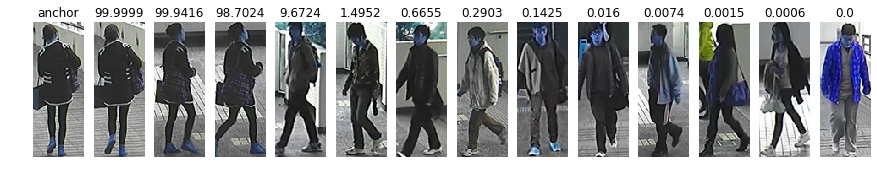

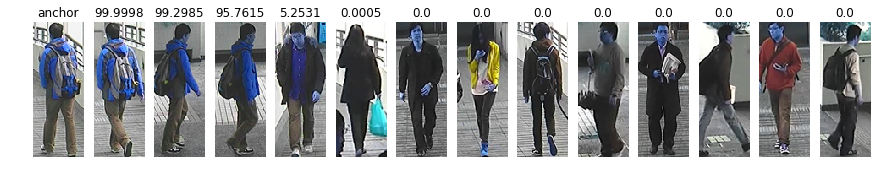

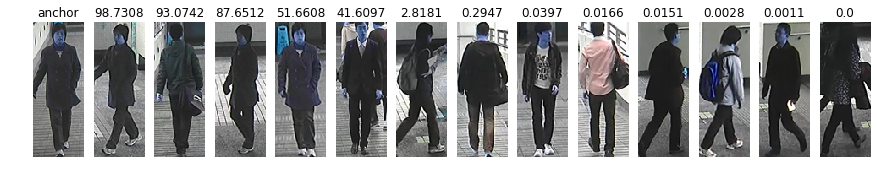

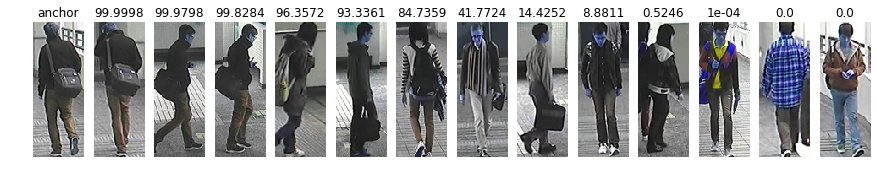

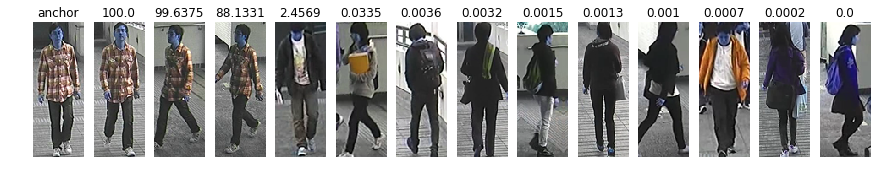

KeyboardInterrupt: 

In [68]:
data_x_size = 160
data_y_size = 60
list_len = len(test_list)
test_dataset = []
#--- 같은 사람들 묶음

saved_name = test_list[0][:4]
front = 0
back = 0
for index, img_name in enumerate(test_list):
    if img_name[:4] == saved_name:
        continue
    saved_name = img_name[:4]
    back = index
    
    if back-front <= 3:
        continue
    test_dataset.append(front)
    test_dataset.extend(random.sample(range(front+1,back),3))
    test_dataset.extend(random.sample(list(range(0,front))+list(range(back,list_len)),10))
    front = index

for i in range(14,1400,14):
    rank = []
    rank_index = []
    img = np.empty((14, data_x_size, data_y_size, 3),dtype=int)
    img[0,:,:,:] = cv2.imread(test_dir+'/'+test_list[test_dataset[i-14]],cv2.IMREAD_COLOR)
    for j in range(i-13,i):
        img[j%14,:,:,:] = cv2.imread(test_dir+'/'+test_list[test_dataset[j]],cv2.IMREAD_COLOR)
    
    answer = sess.run(tf.sigmoid(model),feed_dict={X1:img[0, :, :, :] * np.ones(13)[:, None, None, None],
                                                   X2:img[1:],
                                                   batch_prob: False})
    rank = answer[:,1]
    rank_index = np.argsort(rank)
    # ranking = (rank[rank_index[::-1]]*100).astype('uint8')
    ranking = np.round((rank[rank_index[::-1]]*100),4)
    fig , ax = plt.subplots(1, 14, figsize=(15,15))
    ax[0].set_axis_off()
    ax[0].imshow(img[0])
    ax[0].set_title("anchor")
    for j in range(1,14):
        ax[j].set_axis_off()
        ax[j].imshow(img[1+rank_index[13-j]])
        ax[j].set_title(ranking[j-1])
    plt.show()
    plt.close(fig)
    

In [20]:
temp_dir = '/home/esdl/tensorflow/campus'
# temp_dir = '/home/esdl/tensorflow/cuhk03_release/images/detected'
# temp_dir = '/home/esdl/tensorflow/Market-1501-v15.09.15/bounding_box_train'
pick_person = 100

temp_list,temp1,temp2,temp_CoN = ALL_Image_Data(temp_dir,pick_person)
temp_index = list(range(len(temp1)))

이미지 파일 총 갯수 :  3884
뽑을 사람 :  100
100 명 만큼의 사람의 사진은 400 장 입니다.


PID : 1
[1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]


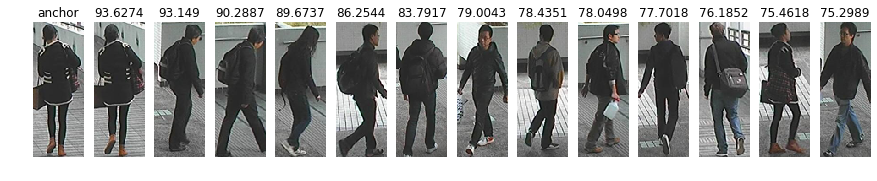

PID : 2
[1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


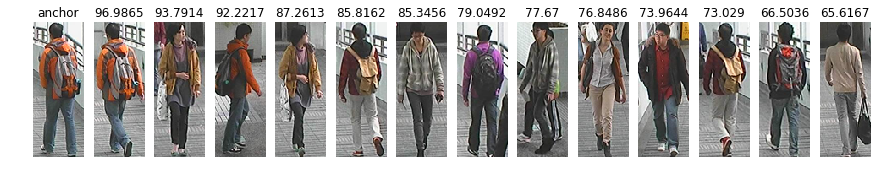

PID : 3
[0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]


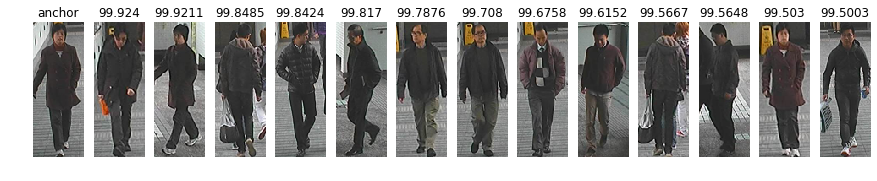

PID : 4
[0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


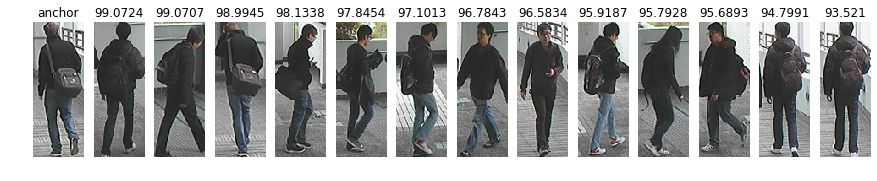

PID : 5
[1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


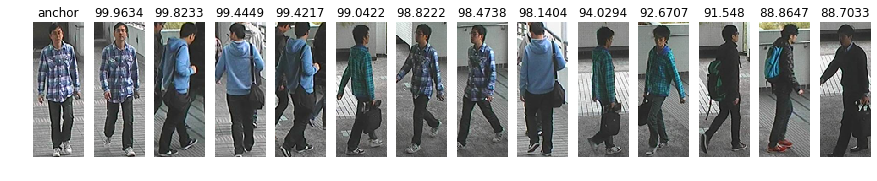

PID : 6
[1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


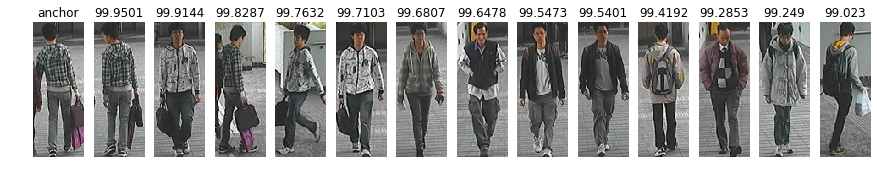

PID : 7
[1 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]


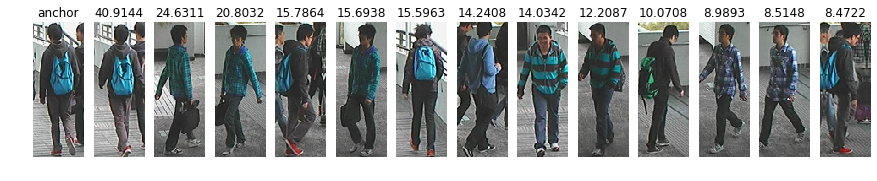

PID : 8
[0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


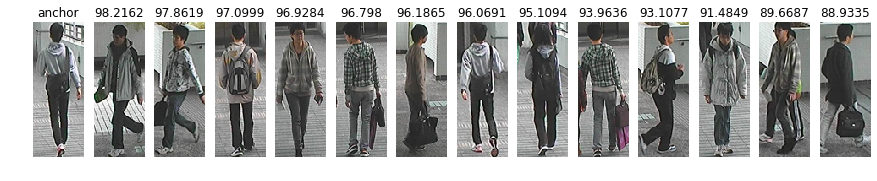

PID : 9
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


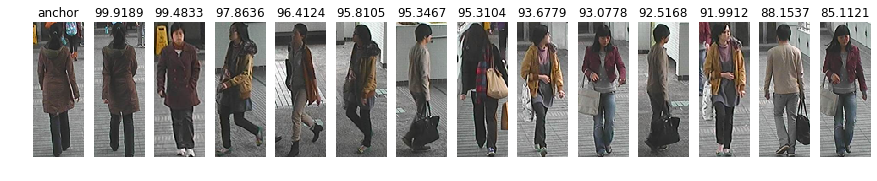

PID : 10
[1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


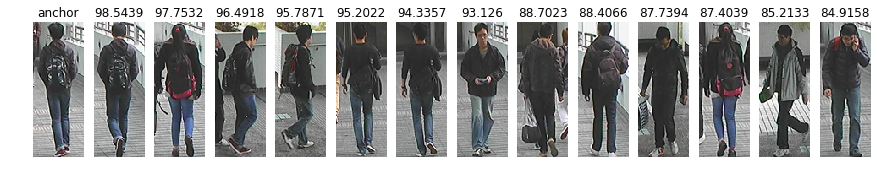

PID : 11
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


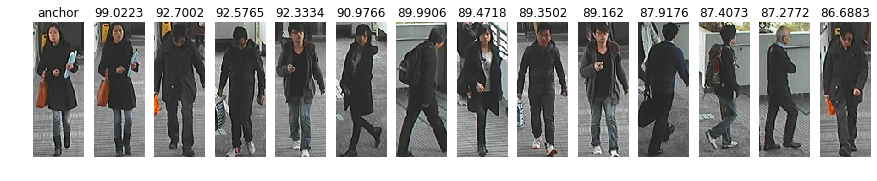

PID : 12
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


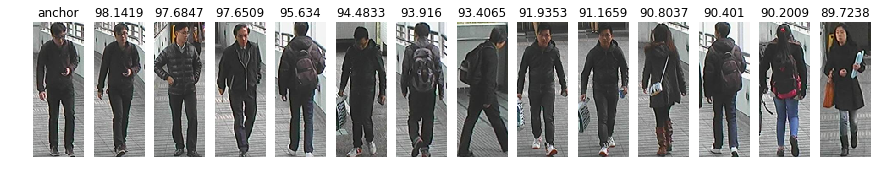

PID : 13
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


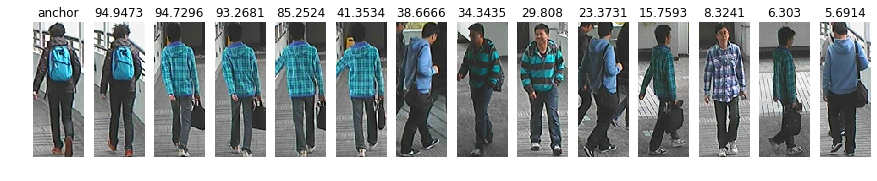

PID : 14
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]


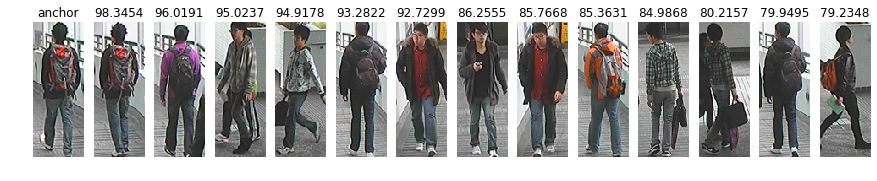

PID : 15
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


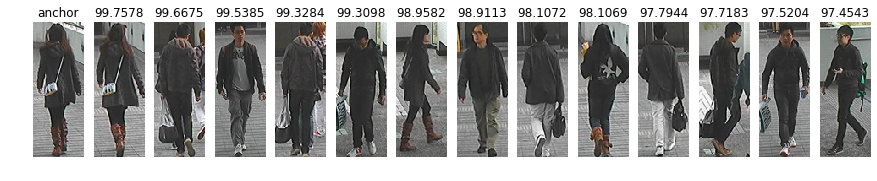

PID : 16
[1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


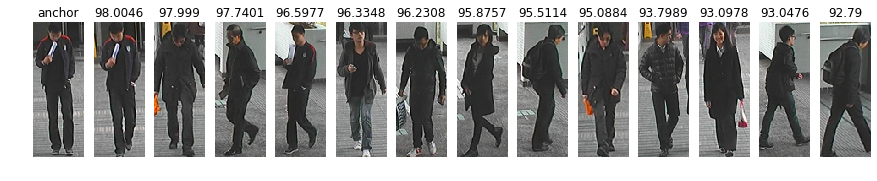

PID : 17
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


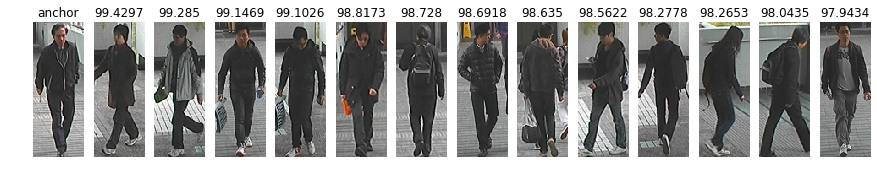

PID : 18
[1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


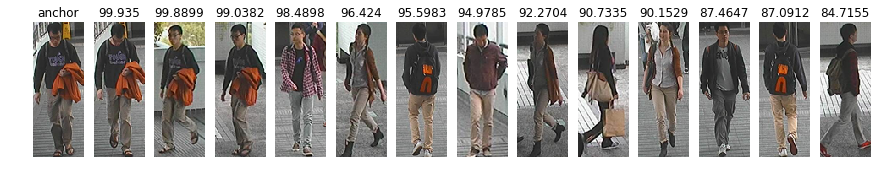

PID : 19
[1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


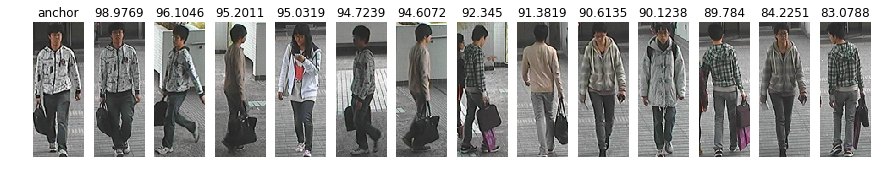

PID : 20
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]


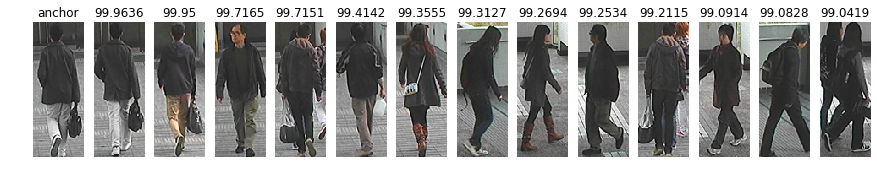

PID : 21
[1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


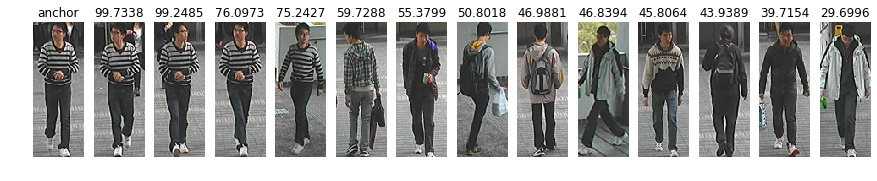

PID : 22
[1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]


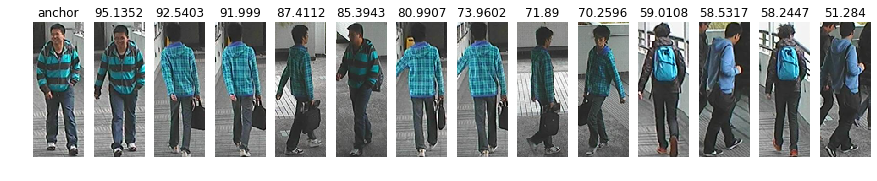

PID : 23
[0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


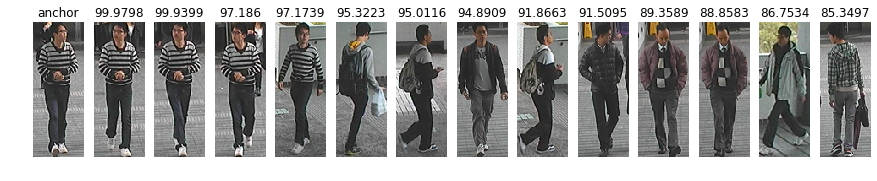

PID : 24
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


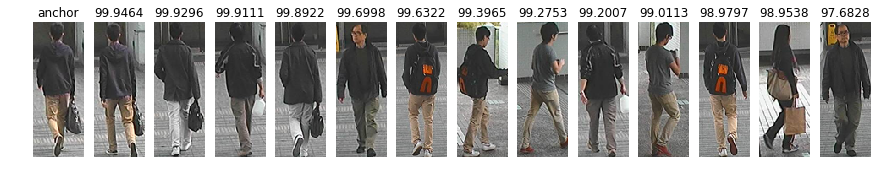

PID : 25
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


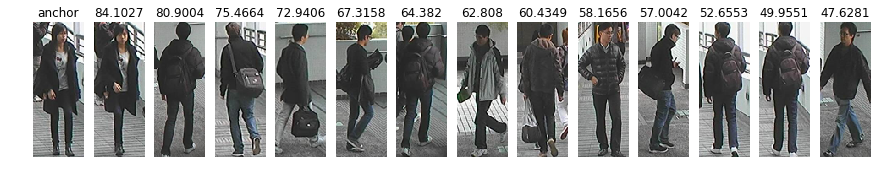

PID : 26
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


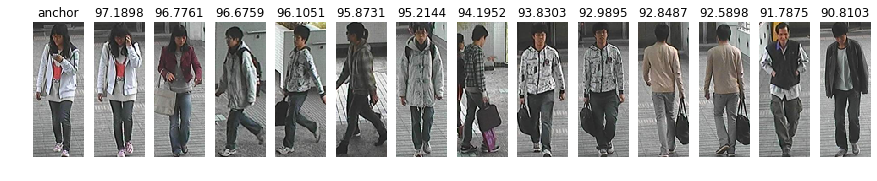

PID : 27
[1 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


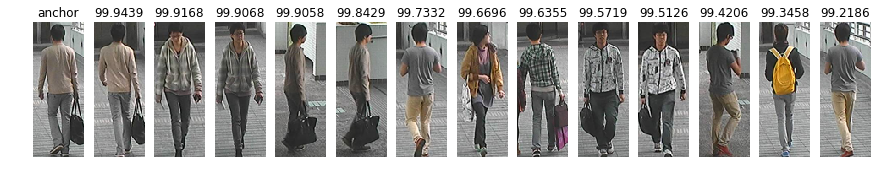

PID : 28
[1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]


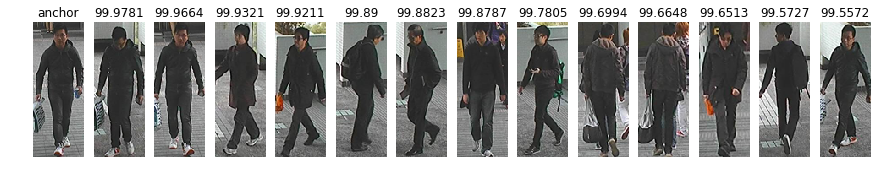

PID : 29
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


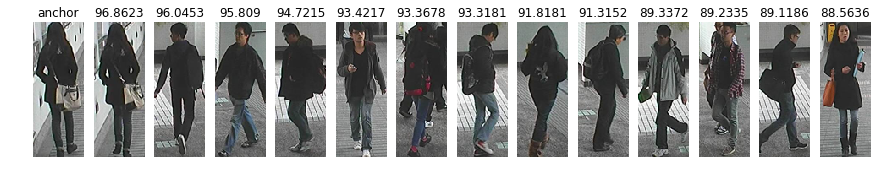

PID : 30
[0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0]


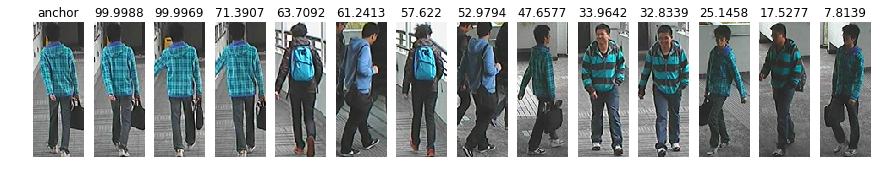

PID : 31
[0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


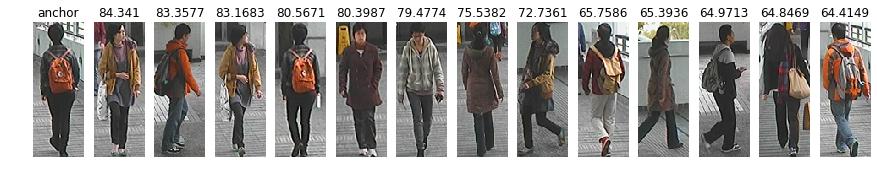

PID : 32
[1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


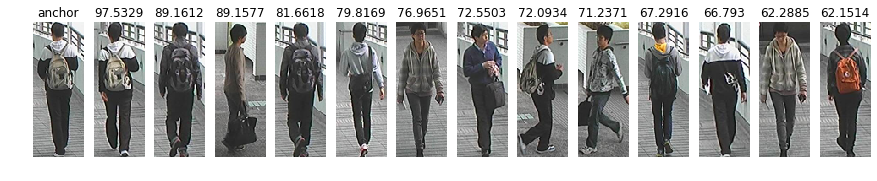

PID : 33
[0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0]


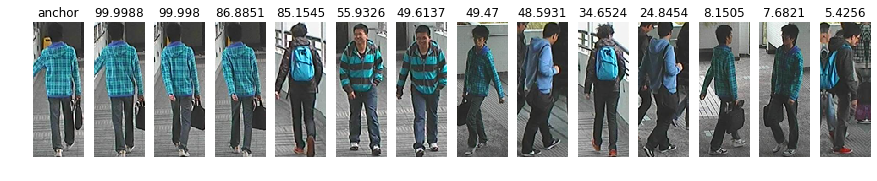

PID : 34
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


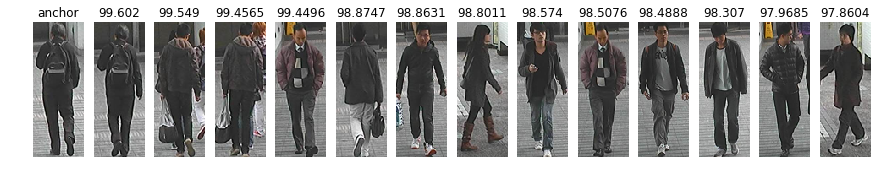

PID : 35
[0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


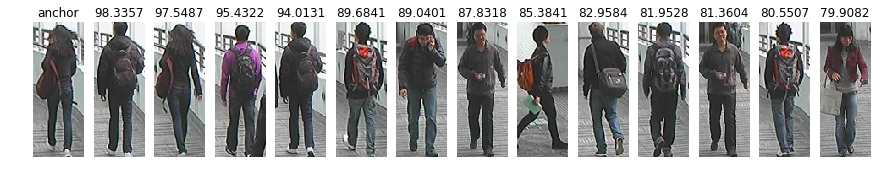

PID : 36
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


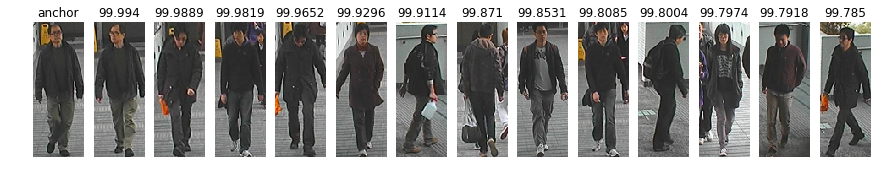

PID : 37
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]


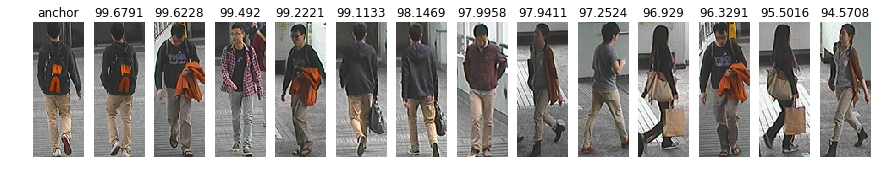

PID : 38
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


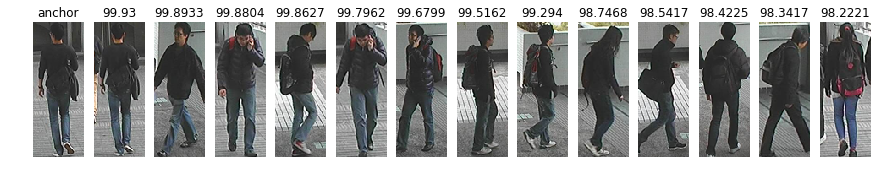

PID : 39
[1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]


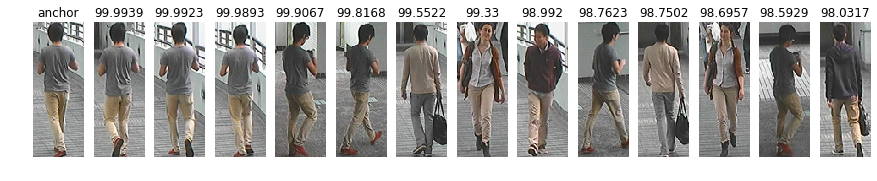

PID : 40
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


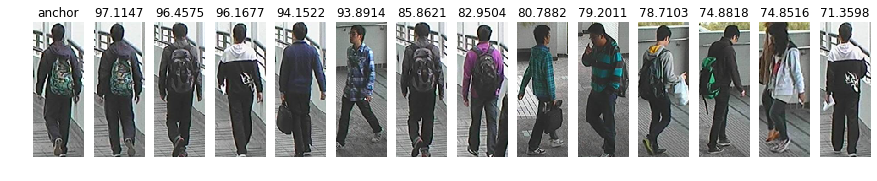

PID : 41
[1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


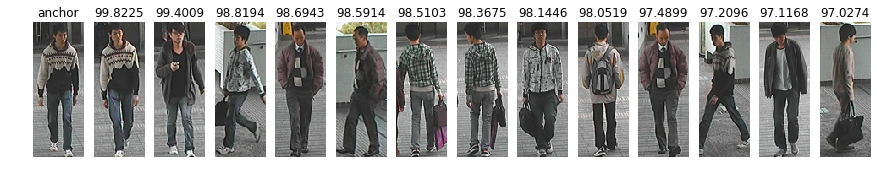

PID : 42
[0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


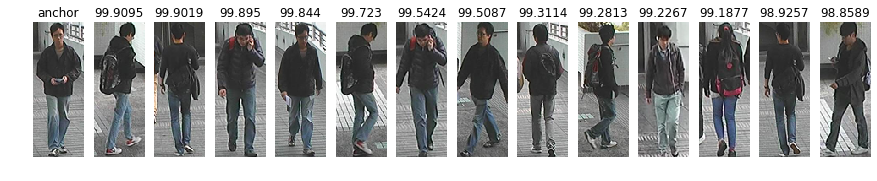

PID : 43
[1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


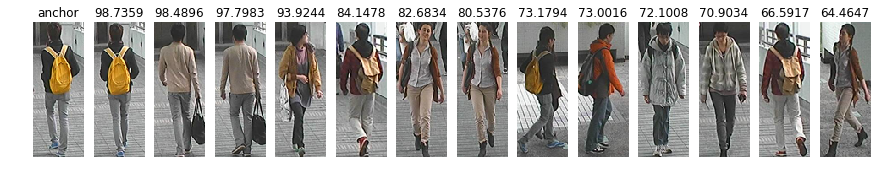

PID : 44
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


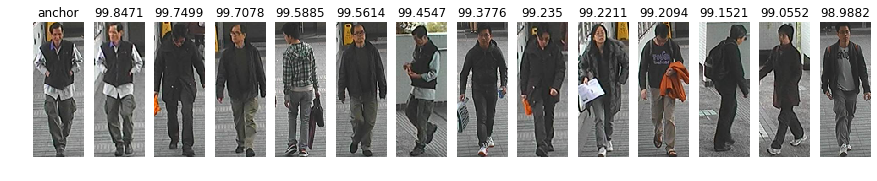

PID : 45
[0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0]


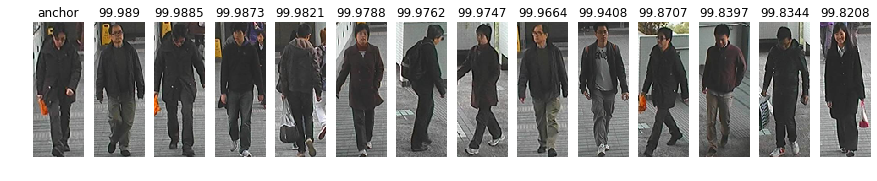

PID : 46
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]


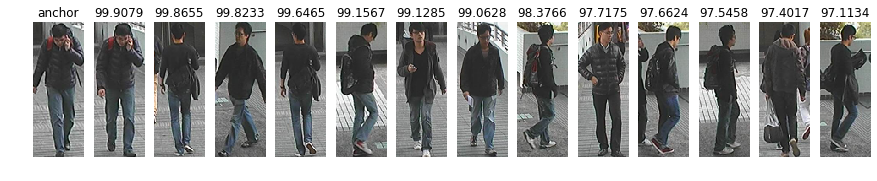

PID : 47
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


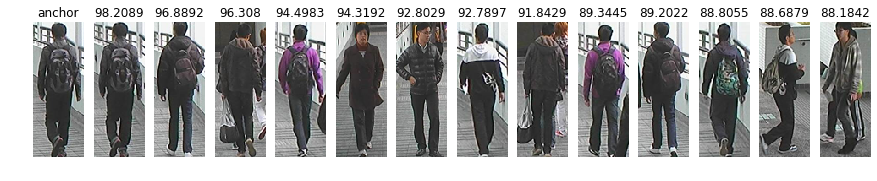

PID : 48
[1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]


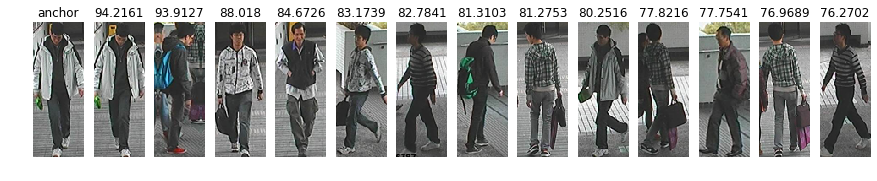

PID : 49
[1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


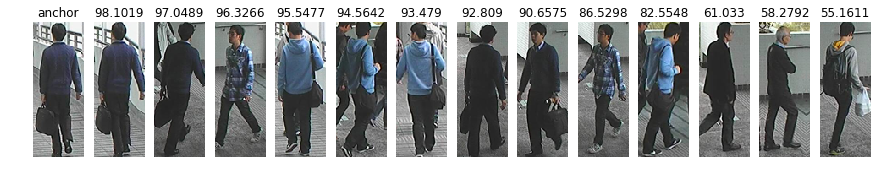

PID : 50
[1 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]


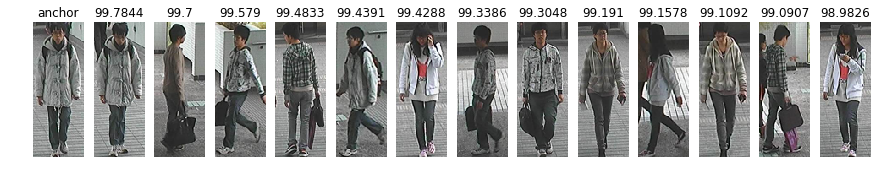

PID : 51
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


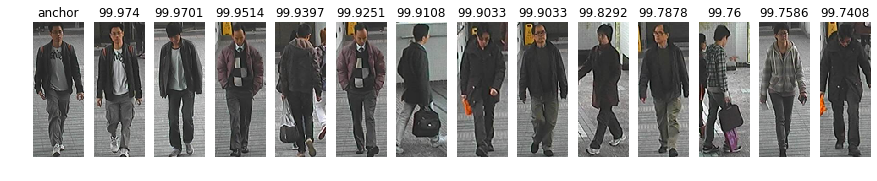

PID : 52
[1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


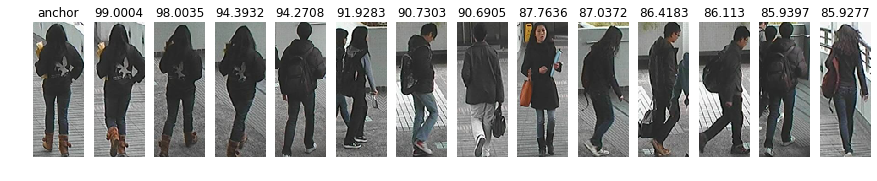

PID : 53
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


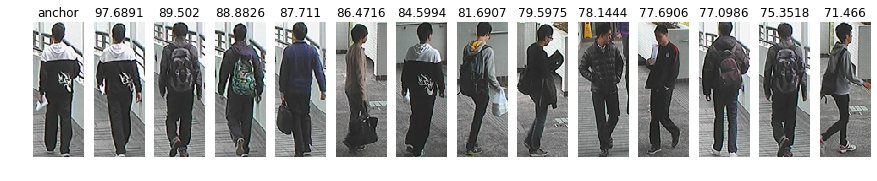

PID : 54
[1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


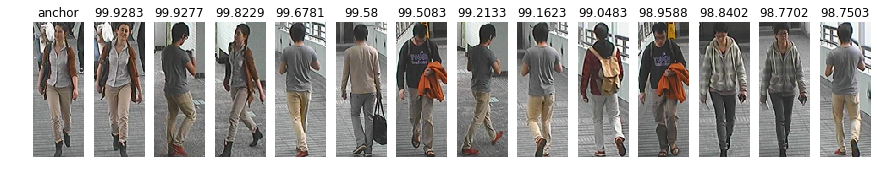

PID : 55
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]


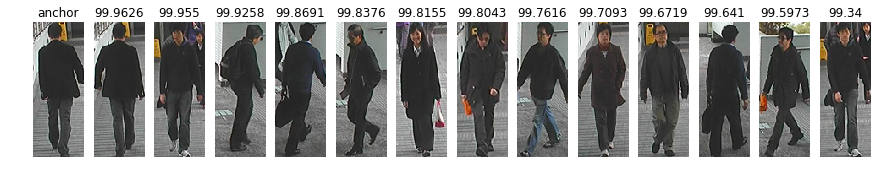

PID : 56
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


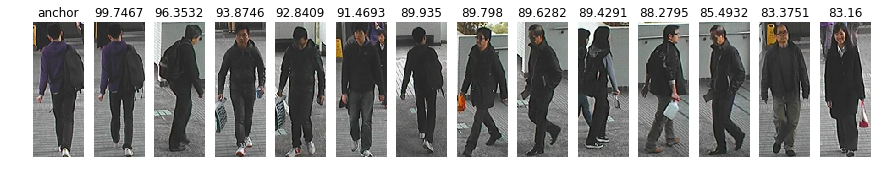

PID : 57
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


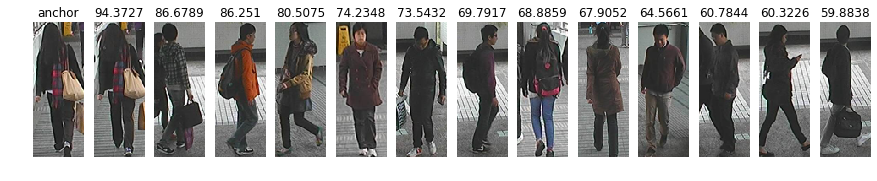

PID : 58
[1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


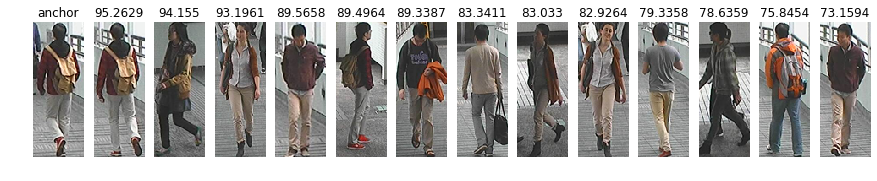

PID : 59
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


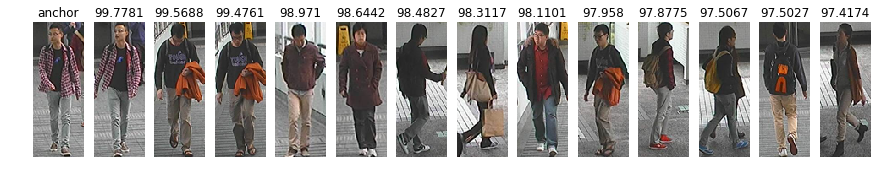

PID : 60
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


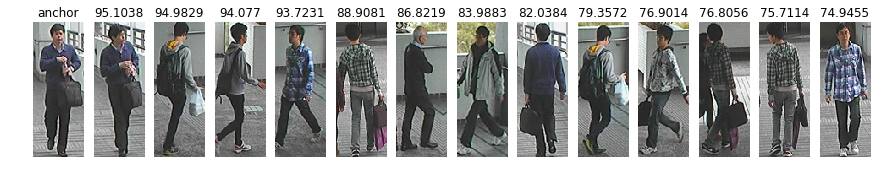

PID : 61
[0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


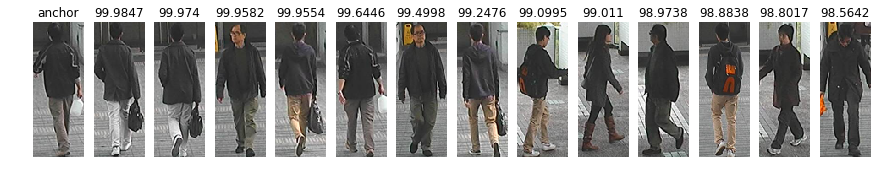

PID : 62
[1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0]


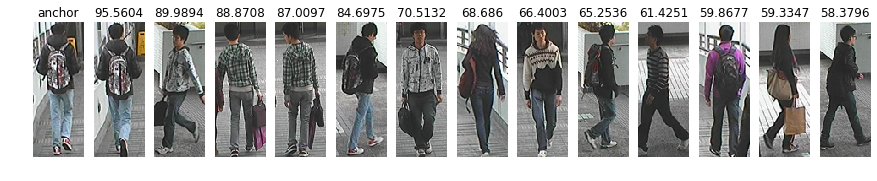

PID : 63
[1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]


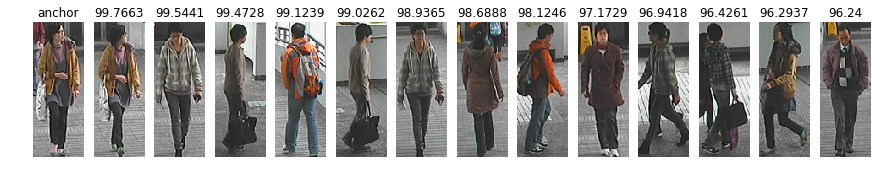

PID : 64
[1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


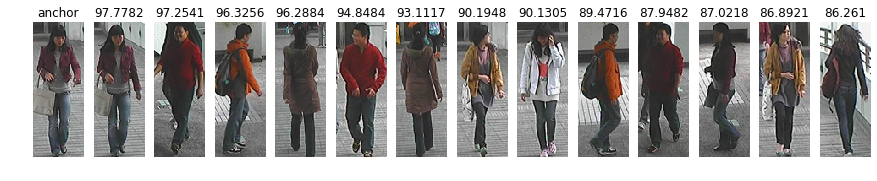

PID : 65
[1 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0]


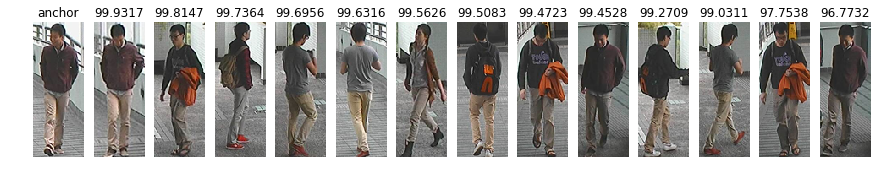

PID : 66
[1 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


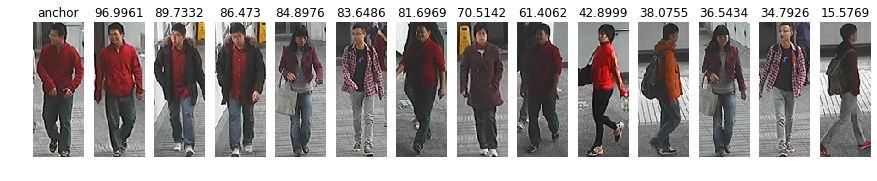

PID : 67
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


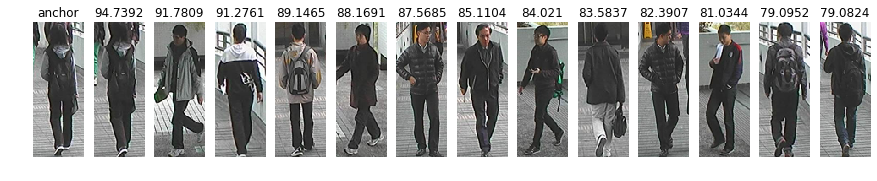

PID : 68
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


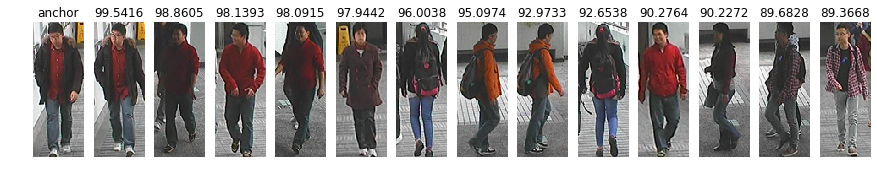

PID : 69
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


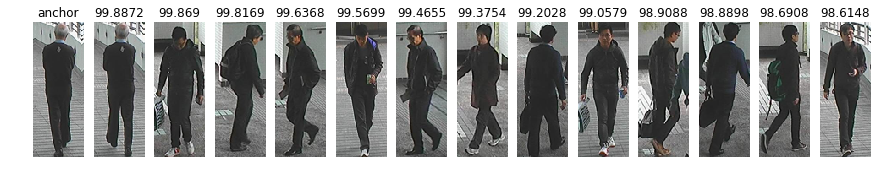

PID : 70
[1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]


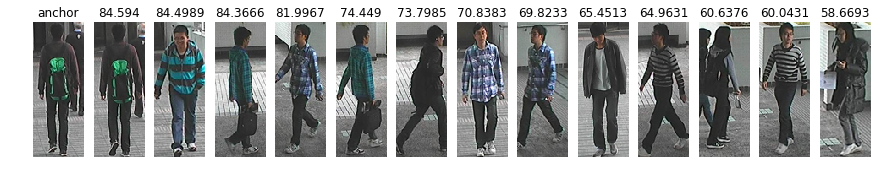

PID : 71
[1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]


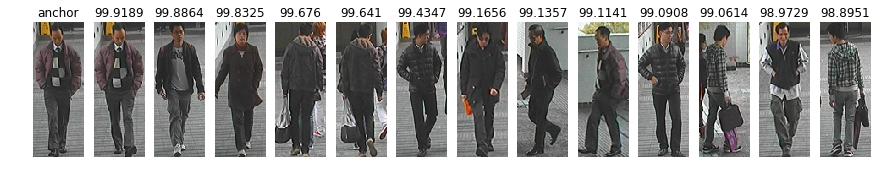

PID : 72
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


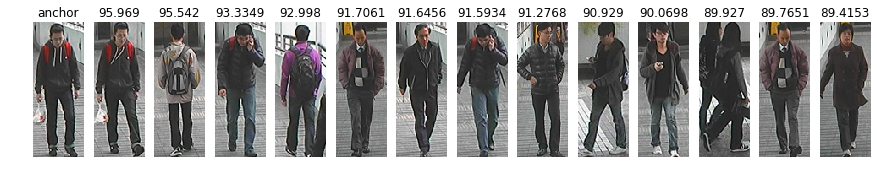

PID : 73
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


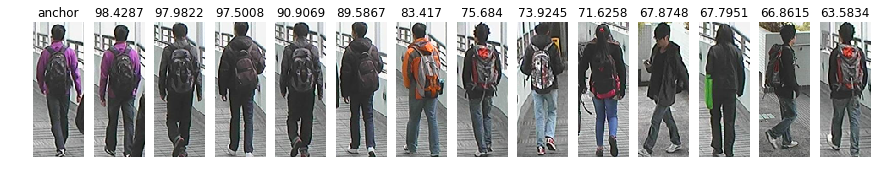

PID : 74
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


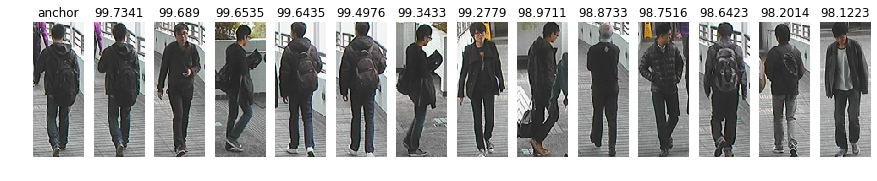

PID : 75
[1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


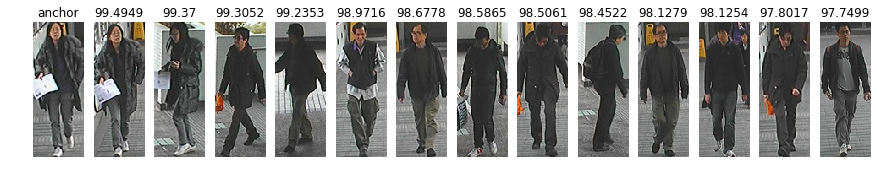

PID : 76
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


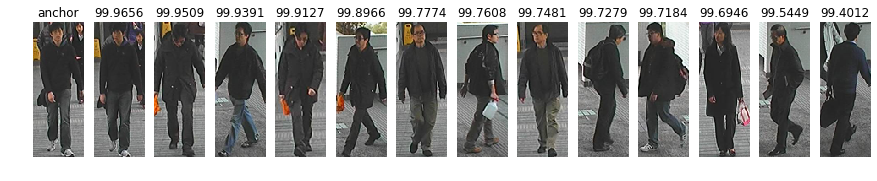

PID : 77
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


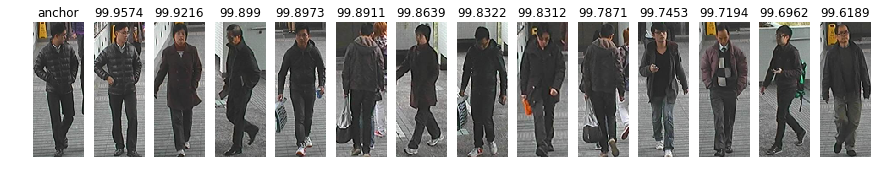

PID : 78
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


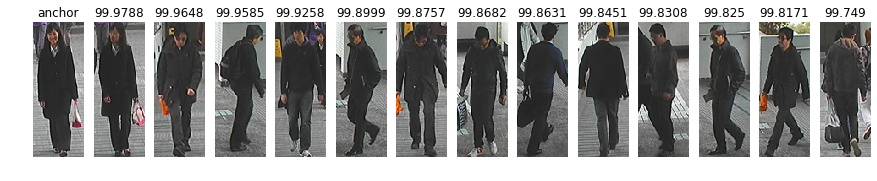

PID : 79
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


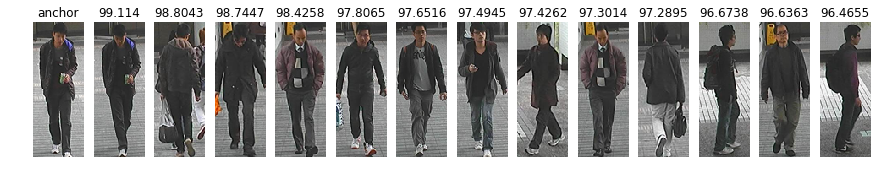

PID : 80
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


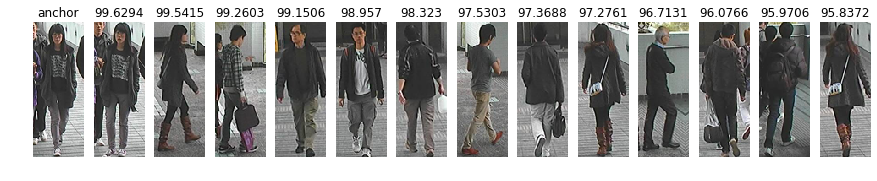

PID : 81
[0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


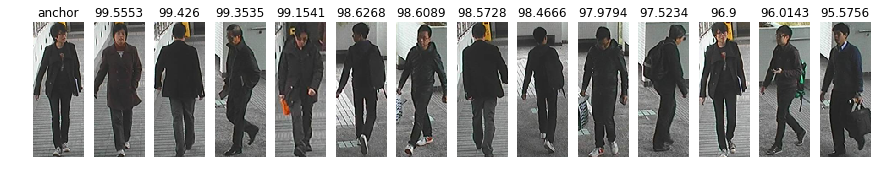

PID : 82
[1 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


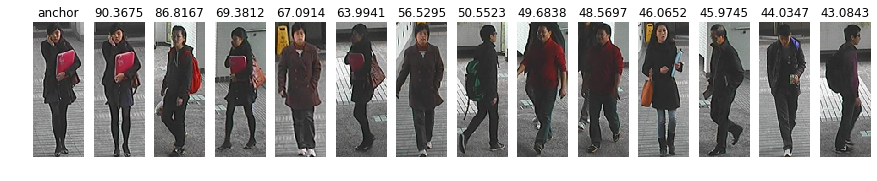

PID : 83
[0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


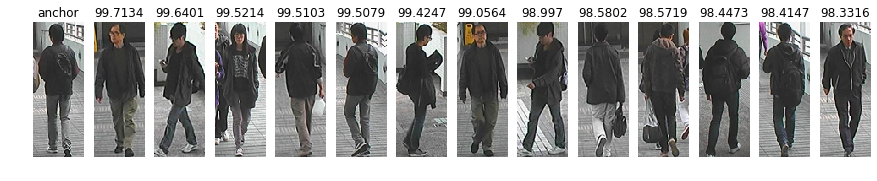

PID : 84
[1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


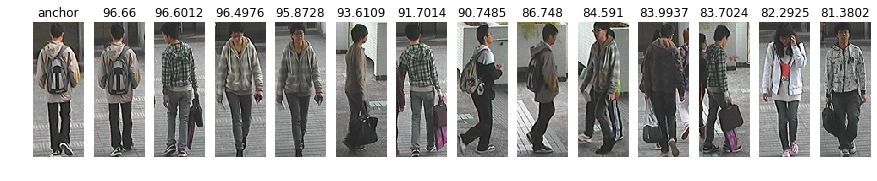

PID : 85
[1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


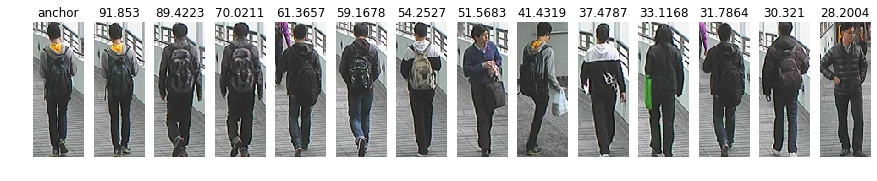

PID : 86
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


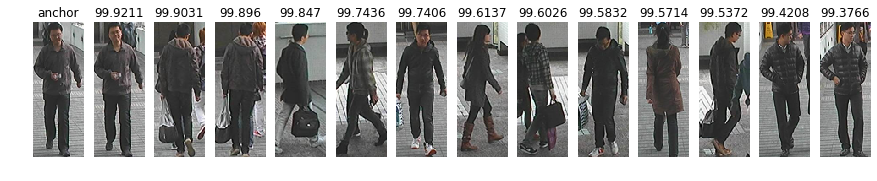

PID : 87
[1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


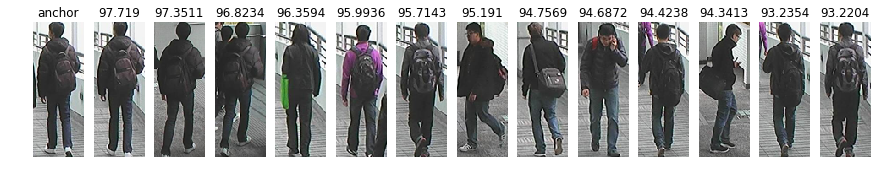

PID : 88
[1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


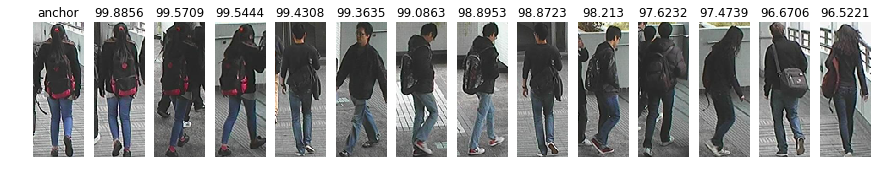

PID : 89
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


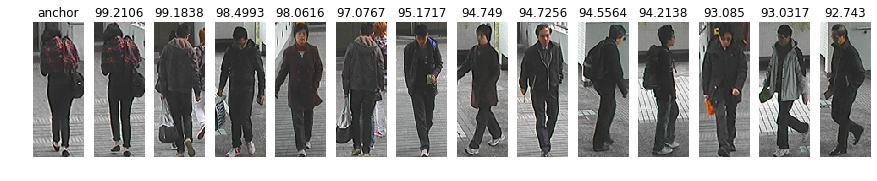

PID : 90
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


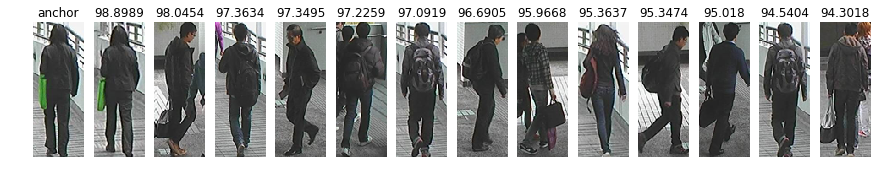

PID : 91
[1 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


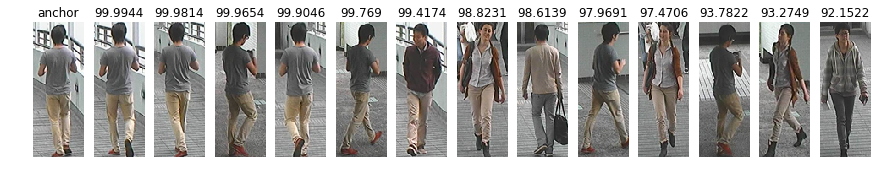

PID : 92
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]


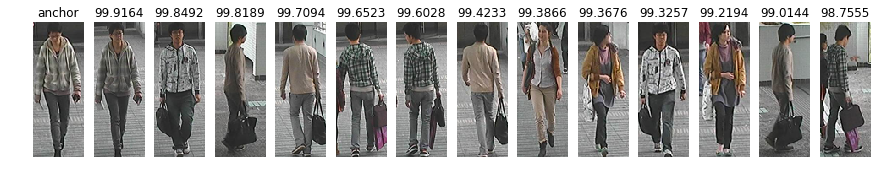

PID : 93
[1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


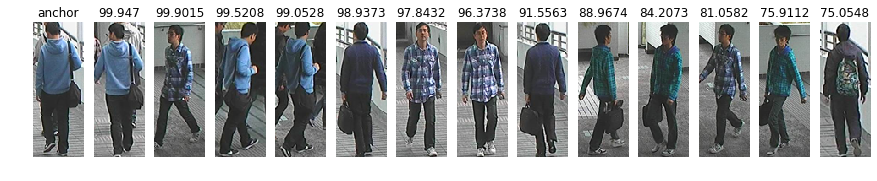

PID : 94
[1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


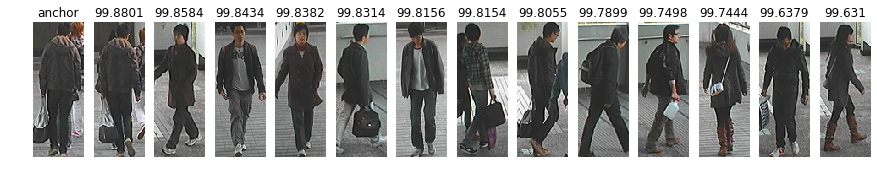

PID : 95
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


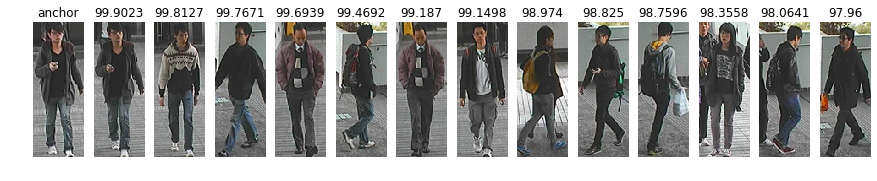

PID : 96
[1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


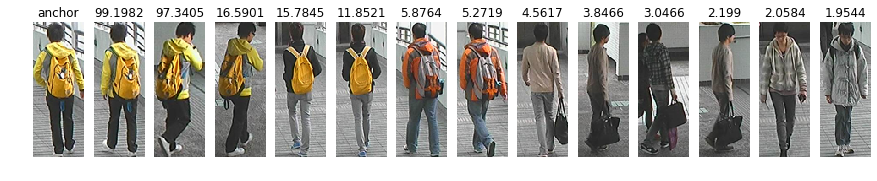

PID : 97
[0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


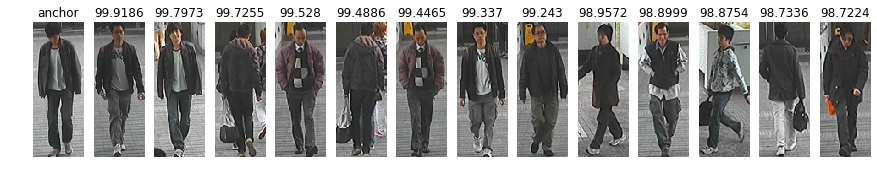

PID : 98
[1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


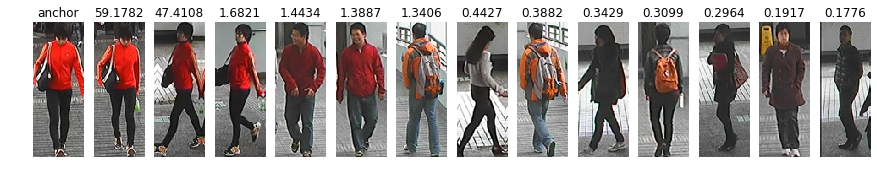

PID : 99
[1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


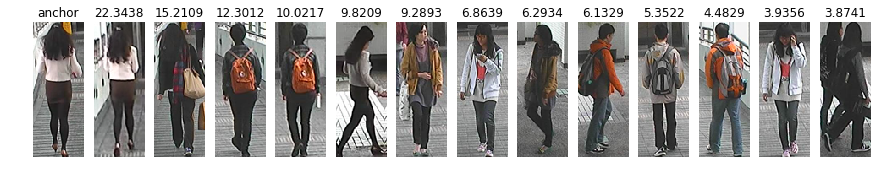

PID : 100
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


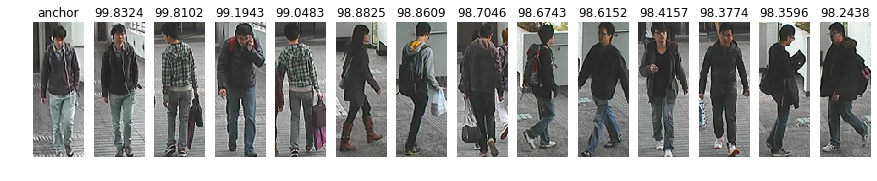

rank = 1 accuarcy is : 85
rank = 5 accuarcy is : 97
rank = 10 accuarcy is : 98
rank = 20 accuarcy is : 100


In [32]:
display = True

data_x_size = 160
data_y_size = 60

start_point = 0

batch_limit = 500
batch = [0, 0, 0] # start, end, length
total_batch = 0
change = temp1[0]
order = 1

rank = []
rank_index = []
total_result = []
rank_accuracy = np.empty((pick_person,20),dtype=int)

for i in range(len(temp1)):
    
    if change == temp1[i] and i+1 != len(temp1) and (i-batch[0]) < batch_limit:
        continue
        
    change = temp1[i]
    batch[1] = i
    batch[2] = batch[1]-batch[0]
    
    if i+1 == len(temp1):
        batch[1] += 1
        batch[2] += 1
        
    img1 = np.empty((batch[2], data_x_size, data_y_size, 3),dtype='uint8')
    img2 = np.empty((batch[2], data_x_size, data_y_size, 3),dtype='uint8')
    result = np.empty(batch[2],dtype=int)
       
    for j in range(0,batch[2]):
        img1[j,:,:,:] = cv2.resize(cv2.imread(temp_dir+'/'+temp_list[temp1[batch[0]+j]],cv2.IMREAD_COLOR),(data_y_size,data_x_size))
        img2[j,:,:,:] = cv2.resize(cv2.imread(temp_dir+'/'+temp_list[temp2[batch[0]+j]],cv2.IMREAD_COLOR),(data_y_size,data_x_size))
        result[j] = temp_CoN[batch[0]+j,1]
    batch[0] = i
    
    answer = sess.run(tf.sigmoid(model),feed_dict={X1:img1, X2:img2, batch_prob: False})
    rank.extend(answer[:,1])
    total_result.extend(result)
    
    if temp1[i] == temp1[i-1] and i+1 != len(temp1): continue
    
    rank = np.array(rank)
    total_result = np.array(total_result)
    rank_index = np.argsort(rank)
    ranking = np.round((rank[rank_index[::-1]]*100),4)
    
    print("PID :",order)
    
    total_result = total_result[rank_index[::-1]][:20]
    rank_accuracy[order-1,:] = total_result
    print(total_result)
    
    order += 1
    
    if display:
        fig , ax = plt.subplots(1, 14, figsize=(15,15))
        ax[0].set_axis_off()
        ax[0].imshow(cv2.cvtColor(img1[0], cv2.COLOR_BGR2RGB))
        ax[0].set_title("anchor")
        for j in range(1,14):
            ax[j].set_axis_off()
            compare_image = cv2.resize(cv2.imread(temp_dir+'/'+temp_list[temp2[start_point+rank_index[-j]]],cv2.IMREAD_COLOR),
                                                                                       (data_y_size,data_x_size))
            #ax[j].imshow(cv2.cvtColor(img2[rank_index[-j]], cv2.COLOR_BGR2RGB))
            ax[j].imshow(cv2.cvtColor(compare_image, cv2.COLOR_BGR2RGB))
            ax[j].set_title(ranking[j])
        plt.show()
        plt.close(fig)
    
    rank = []
    rank_index = []
    total_result = []
    start_point = i

print("rank = 1 accuarcy is :",rank_accuracy[:,0].sum(axis=0))
print("rank = 5 accuarcy is :",(rank_accuracy[:,:5].sum(axis=1)>0).astype(int).sum(axis=0))
print("rank = 10 accuarcy is :",(rank_accuracy[:,:10].sum(axis=1)>0).astype(int).sum(axis=0))
print("rank = 20 accuarcy is :",(rank_accuracy[:,:20].sum(axis=1)>0).astype(int).sum(axis=0))

In [ ]:
sess.close()

In [ ]:
test_size = 11

data_x_size = 160
data_y_size = 60

for i in range(test_size):
    test_img1 = np.empty((1, data_x_size, data_y_size,3))
    test_img2 = np.empty((1, data_x_size, data_y_size,3))
    
    test_img1[0,:,:,:] = cv2.resize(cv2.imread('/home/esdl/tensorflow/test_data/1.jpg',cv2.IMREAD_COLOR), (data_y_size, data_x_size)) 
    test_img2[0,:,:,:] = cv2.resize(cv2.imread('/home/esdl/tensorflow/test_data/'+str(i+1)+'.jpg',cv2.IMREAD_COLOR), (data_y_size, data_x_size))
    #test_img2[0,:,:,:] = cv2.resize(cv2.imread('/home/esdl/tensorflow/campus/0030001.png',cv2.IMREAD_COLOR), (data_y_size, data_x_size))
    
    test_img1 = test_img1.reshape(-1,data_x_size,data_y_size,3)
    test_img2 = test_img2.reshape(-1,data_x_size,data_y_size,3)
    answer = sess.run(tf.nn.softmax(model),feed_dict={X1:test_img1, X2:test_img2, batch_prob: False})
    print(answer)
    
    img1 = cv2.imread('/home/esdl/tensorflow/test_data/1.jpg',cv2.IMREAD_COLOR)
    img2 = cv2.imread('/home/esdl/tensorflow/test_data/'+str(i+1)+'.jpg',cv2.IMREAD_COLOR)
    #img2 = cv2.imread('/home/esdl/tensorflow/campus/0030001.png',cv2.IMREAD_COLOR)
    
    fig , ax = plt.subplots(1, 2)
    ax[0].set_axis_off()
    ax[1].set_axis_off()

    ax[0].imshow(img1)
    ax[1].imshow(img2)
    
    if answer[0,0] < answer[0,1]:
        print("NN answer is = SAME")
    else:
        print("NN answer is = Different")
    plt.show()
    plt.close(fig)

In [ ]:
#test_size = len(data1)
test_size = 100

data_x_size = 160
data_y_size = 60

test_accuracy = []
for i in range(test_size):
    test_data1 = np.empty((1, data_x_size, data_y_size,3))
    test_data2 = np.empty((1, data_x_size, data_y_size,3))
    test_data1[0,:,:,:] = cv2.resize(cv2.imread(path_dir+'/'+file_list[data1[data_index[i]]],cv2.IMREAD_COLOR), (data_y_size, data_x_size)) 
    test_data2[0,:,:,:] = cv2.resize(cv2.imread(path_dir+'/'+file_list[data2[data_index[i]]],cv2.IMREAD_COLOR), (data_y_size, data_x_size))
    test_data1 = test_data1.reshape(-1,data_x_size,data_y_size,3)
    test_data2 = test_data2.reshape(-1,data_x_size,data_y_size,3)
    answer = sess.run(tf.nn.softmax(model),feed_dict={X1:test_data1, X2:test_data2,})
    print(answer)
    
    img1 = cv2.imread(path_dir+'/'+file_list[data1[data_index[i]]],cv2.IMREAD_COLOR)
    img2 = cv2.imread(path_dir+'/'+file_list[data2[data_index[i]]],cv2.IMREAD_COLOR)
    fig , ax = plt.subplots(1, 2)
    ax[0].set_axis_off()
    ax[1].set_axis_off()

    ax[0].imshow(img1)
    ax[1].imshow(img2)
    
    
    print("first pic = ",file_list[data1[data_index[i]]])
    print("second pic = ",file_list[data2[data_index[i]]])
    print("answer is = ",CoN[data_index[i]])
    if answer[0,0] < answer[0,1]:
        print("NN answer is = SAME")
        test_accuracy.append(CoN[data_index[i]][1])
    else:
        print("NN answer is = Different")
        test_accuracy.append(CoN[data_index[i]][0])
    plt.show()
    plt.close(fig)
print("정확도는 = ",sum(test_accuracy)/len(test_accuracy))

In [ ]:
#test_size = len(data1)
test_size = 100

data_x_size = 160
data_y_size = 60

test_accuracy = []
for i in range(test_size):
    test_img1 = np.empty((1, data_x_size, data_y_size,3))
    test_img2 = np.empty((1, data_x_size, data_y_size,3))
    test_img1[0,:,:,:] = cv2.resize(cv2.imread(test_path_dir+'/'+p_list[test_data1[test_data_index[i]]],cv2.IMREAD_COLOR), (data_y_size, data_x_size)) 
    test_img2[0,:,:,:] = cv2.resize(cv2.imread(test_path_dir+'/'+p_list[test_data2[test_data_index[i]]],cv2.IMREAD_COLOR), (data_y_size, data_x_size))
    test_img1 = test_img1.reshape(-1,data_x_size,data_y_size,3)
    test_img2 = test_img2.reshape(-1,data_x_size,data_y_size,3)
    answer = sess.run(tf.nn.softmax(model),feed_dict={X1:test_img1, X2:test_img2,})
    print(answer)
    
    img1 = cv2.imread(test_path_dir+'/'+p_list[test_data1[test_data_index[i]]],cv2.IMREAD_COLOR)
    img2 = cv2.imread(test_path_dir+'/'+p_list[test_data2[test_data_index[i]]],cv2.IMREAD_COLOR)
    fig , ax = plt.subplots(1, 2)
    ax[0].set_axis_off()
    ax[1].set_axis_off()

    ax[0].imshow(img1)
    ax[1].imshow(img2)
    
    
    print("first pic = ",p_list[test_data1[test_data_index[i]]])
    print("second pic = ",p_list[test_data2[test_data_index[i]]])
    print("answer is = ",CoN[data_index[i]])
    if answer[0,0] < answer[0,1]:
        print("NN answer is = SAME")
        test_accuracy.append(test_CoN[test_data_index[i]][1])
    else:
        print("NN answer is = Different")
        test_accuracy.append(test_CoN[test_data_index[i]][0])
    plt.show()
    plt.close(fig)
print("정확도는 = ",sum(test_accuracy)/len(test_accuracy))

In [ ]:
path_dir = '/home/esdl/tensorflow/Market-1501-v15.09.15/bounding_box_train'
file_list = os.listdir(path_dir)
file_list.sort()

list_len = len(file_list)
print("이미지 파일 총 갯수 : ",list_len)

file_list_random = list(range(list_len))
random.shuffle(file_list_random)

data1=[]
data2=[]
CoN=[] # correct[0 1] or not[1 0]

#--- 같은 사람들 묶음

pick_num = 10# 같은사람당 뽑을 묶음 수
saved_name = file_list[0][:4]
front = 0
back = 0
for index, img_name in enumerate(file_list):
    if img_name[:4] == saved_name:
        continue
    
    saved_name = img_name[:4]
    back = index
    for i in range(pick_num):
        D1,D2 = random.sample(range(front,back),2)
        data1.append(D1)
        data2.append(D2)
        CoN.append([0,1])
    
    front = index

#--- 다른 사람들 묶음

for index in range(0,list_len,2):
    D1 = file_list_random[index]
    D2 = file_list_random[index+1]
    data1.append(D1)
    data2.append(D2)
    if file_list[D1][:4] == file_list[D2][:4]:
        CoN.append([0,1])
    else:
        CoN.append([1,0])

CoN=np.asarray(CoN)


data_index = list(range(len(data1)))
random.shuffle(data_index)

nsp, sp = np.sum(CoN,axis=0)
print("같은사람 : ",sp)
print("다른사람 : ",nsp)

for i in data_index[:10]:
    img1 = cv2.imread(path_dir+'/'+file_list[data1[i]],cv2.IMREAD_COLOR)
    img2 = cv2.imread(path_dir+'/'+file_list[data2[i]],cv2.IMREAD_COLOR)
    fig , ax = plt.subplots(1, 2)
    ax[0].set_axis_off()
    ax[1].set_axis_off()

    ax[0].imshow(img1)
    ax[1].imshow(img2)
    
    print("first pic = ",file_list[data1[i]])
    print("second pic = ",file_list[data2[i]])
    print("answer is = ",CoN[i])
    plt.show()
    plt.close(fig)

In [ ]:
data_x_size = 160
data_y_size = 60
list_len = len(file_list)

test_dataset = []
#--- 같은 사람들 묶음

saved_name = file_list[0][:4]
front = 0
back = 0
for index, img_name in enumerate(file_list):
    if img_name[:4] == saved_name:
        continue
    
    saved_name = img_name[:4]
    back = index
    if back-front <= 5:
        continue
        
    test_dataset.append(front)
    test_dataset.extend(random.sample(range(front+1,back),4))
    test_dataset.extend(random.sample(range(back,list_len+1),5))
    front = index
    
for i in range(10,500,10):
    rank = []
    rank_index = []
    img = np.empty((10, data_x_size, data_y_size, 3),dtype=int)
    
    for j in range(i-10,i):
        img[j%10,:,:,:] = cv2.resize(cv2.imread(path_dir+'/'+file_list[test_dataset[j]],cv2.IMREAD_COLOR), (data_y_size, data_x_size))
        answer = sess.run(tf.sigmoid(model),feed_dict={X1:img[0].reshape(-1,data_x_size,data_y_size,3),
                                                       X2:img[j%10].reshape(-1,data_x_size,data_y_size,3),
                                                       batch_prob: False})
        rank.append(answer[0][1])
    rank_index = sorted(range(len(rank)), key=lambda k: rank[k])
    rank.sort(reverse = True) 
    print(rank)
    plt.imshow(img[0])
    plt.show()
    fig , ax = plt.subplots(1, 10)
    for j in range(10):
        ax[j].set_axis_off()
        ax[j].imshow(img[rank_index[9-j]])
        ax[j].set_title(j)
    plt.show()
    plt.close(fig)
    